In [1]:
# import necessary packages
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

In [2]:
# set the parameters for figure
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(6,6))
#plt.rcParams['figure.figsize'] = (6,6)

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


# Load raw data

In [4]:
adata = sc.read_10x_h5('project/filtered_feature_bc_matrix.h5', gex_only=False)
adata

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 38790 × 191946
    var: 'gene_ids', 'feature_types', 'genome'

In [5]:
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 38790 × 191946
    var: 'gene_ids', 'feature_types', 'genome'

In [6]:
adata.obs['samp'] = [idx.split('-')[1] for idx in adata.obs_names]

In [7]:
adata.obs['samp'].value_counts()

5    10062
1     8442
2     8341
4     6319
3     5626
Name: samp, dtype: int64

In [8]:
sample_map = {'1': 'S1D1',
 '2': 'S1D2',
 '3': 'S1D3',
 '4': 'S2D1',
 '5': 'S2D2'
}

adata.obs['sample'] = [sample_map[s] for s in adata.obs['samp']]
del adata.obs['samp']

In [9]:
adata.obs['sample'].value_counts()

S2D2    10062
S1D1     8442
S1D2     8341
S2D1     6319
S1D3     5626
Name: sample, dtype: int64

In [10]:
adata_s1d1 = adata[adata.obs['sample'].isin(['S1D1'])].copy()

In [11]:
adata_atac = adata_s1d1[:,adata_s1d1.var['feature_types'].isin(['Peaks'])].copy()
adata_gex = adata_s1d1[:,adata_s1d1.var['feature_types'].isin(['Gene Expression'])].copy()
adata_atac
adata_gex

AnnData object with n_obs × n_vars = 8442 × 36601
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [12]:
adata_gex.var_names_make_unique()

# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [13]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [14]:
%R library(scran)

'scran','scuttle','SingleCe...,...,'datasets','methods','base'


# QC

QC is done mainly by filtering jointly on the number of counts, the number of genes, and considering the fraction of mitochondrial reads

In [15]:
# Compute QC metrics
adata_gex.var["mt"] = adata_gex.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_gex, qc_vars=["mt"], inplace=True)

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


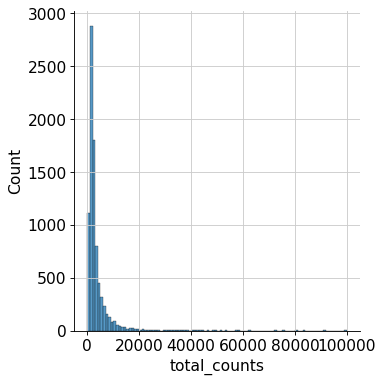

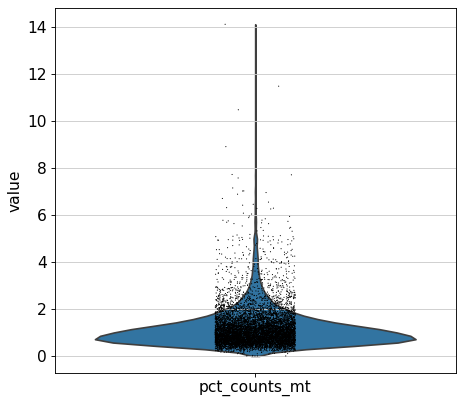

In [16]:
t1 = sns.displot(adata_gex.obs['total_counts'], bins=100, kde=False)
t2 = sc.pl.violin(adata_gex, 'pct_counts_mt')

Note there is quite low MT read fraction (mostly <5%), so might not need to filter on this, unless this coincides with low count depth and low number of genes.

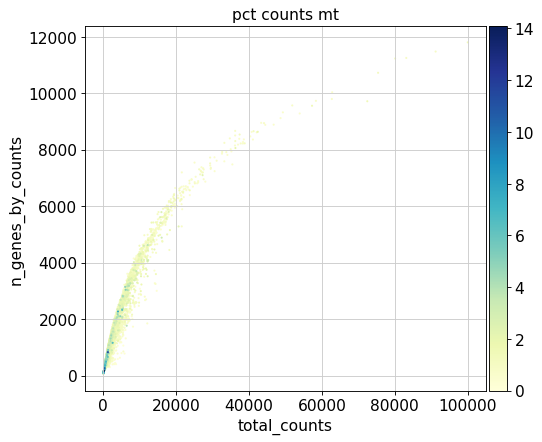

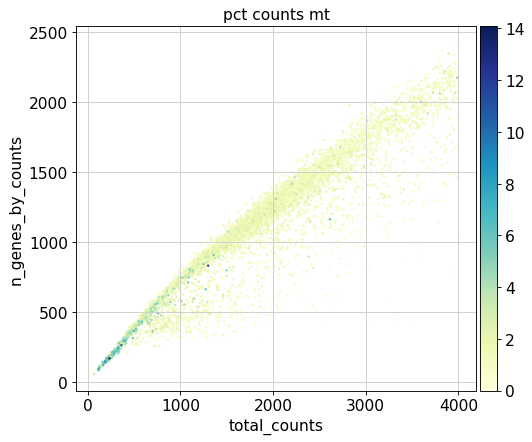

In [17]:
#Data quality summary plots
plt.rcParams['figure.figsize'] = (6,6)
p1 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')
p2 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<4000], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


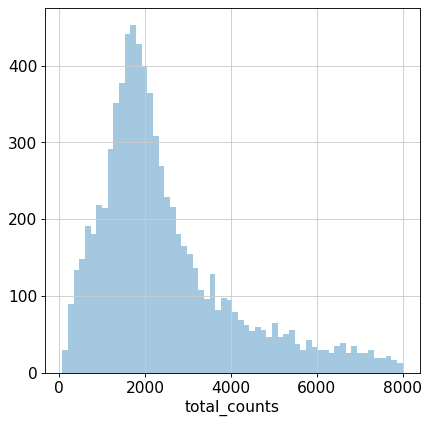

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


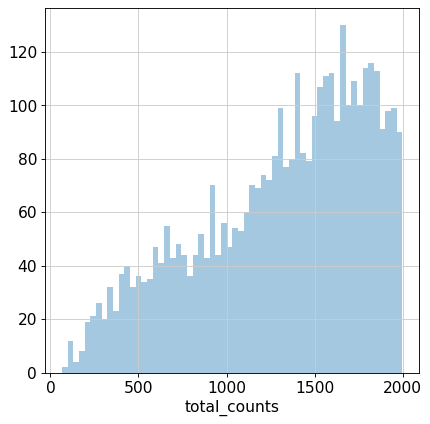

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


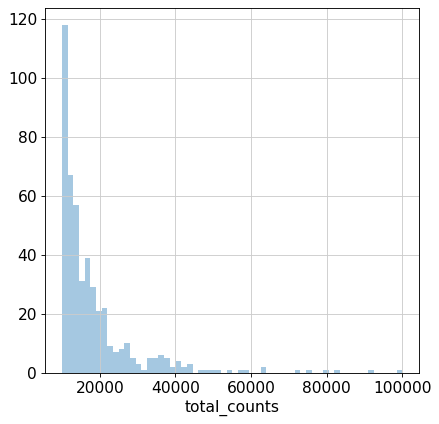

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


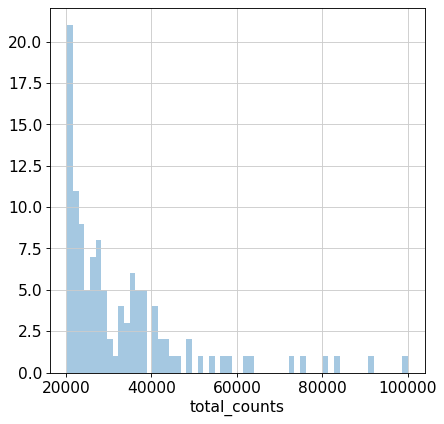

In [18]:
#Thresholding decision: counts
# Here we check the univariate distributions for low-quality outlier peaks. We especially zoom in on lower values
p3 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<8000], kde=False, bins=60)
plt.show()

p4 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<2000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>10000], kde=False, bins=60)
plt.show()

p6 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>20000], kde=False, bins=60)
plt.show()

Thresholding options:

Lower bound:
- 250
- 620 -> use this
- 1100

Upper bound:
- 25,000 -> go for this
- 32,000
- 50,000

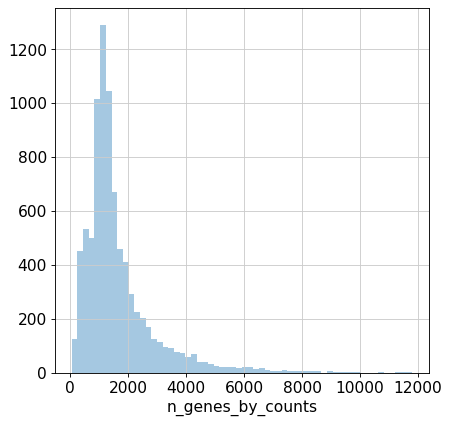

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


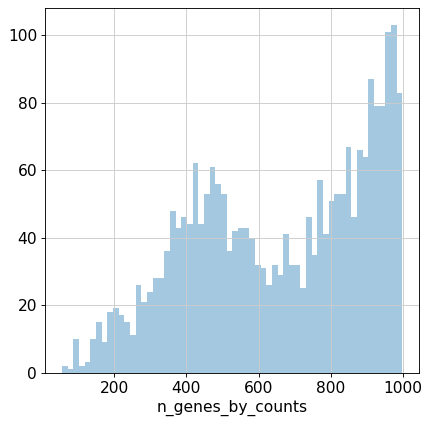

In [19]:
#Thresholding decision: genes

p7 = sns.distplot(adata_gex.obs['n_genes_by_counts'], kde=False, bins=60)
plt.show()

p8 = sns.distplot(adata_gex.obs['n_genes_by_counts'][adata_gex.obs['n_genes_by_counts']<1000], kde=False, bins=60)
plt.show()


Gene thresholding options:
- 280 -> try this first
- 670

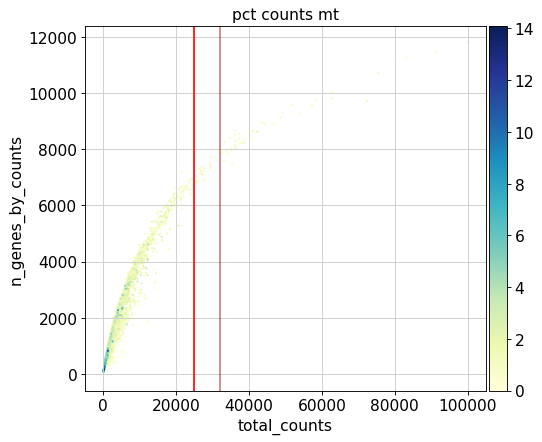

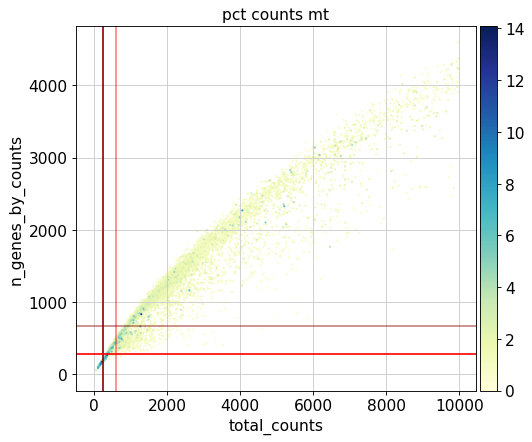

In [20]:
# Visualize the chosen thresholds jointly, before filtering out cells
counts_upper = 25000
counts_upper_alt = 32000
counts_lower = 620
counts_lower_alt = 250
genes_lower = 280
genes_lower_alt = 670

p9 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p9.axline((counts_upper,0),(counts_upper,1), color='red')
p9.axline((counts_upper_alt,0),(counts_upper_alt,1), color='darkred', alpha=0.5)
plt.show()

count_lim = 10000
p10 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<count_lim], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p10.axline((counts_lower,0),(counts_lower,1), color='red', alpha=0.5)
p10.axline((counts_lower_alt,0),(counts_lower_alt,1), color='darkred')
p10.axline((0,genes_lower),(1,genes_lower), color='red')
p10.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

Final thresholding decisions:
- Counts lower: 620 (but 250 might work too)
- Counts upper: 25k is fine
- Genes: 280 is final
- no MT threshold is needed

These thresholds were chosen to preserve the group of cells moving away from the main distribution at around 620 counts, but still remove most higher MT fraction cells. Using a less permissive upper count threshold is fine, as these cells are often challenging to annotate and might be doublets.

In [21]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_counts = 620)
print('Number of cells after min count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, max_counts = 25000)
print('Number of cells after max count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_genes = 280)
print('Number of cells after gene filter: {:d}'.format(adata_gex.n_obs))

Total number of cells: 8442
Number of cells after min count filter: 8008
Number of cells after max count filter: 7934
Number of cells after gene filter: 7931


In [22]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_gex.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_gex, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_gex.n_vars))

Total number of genes: 36601
Number of genes after cell filter: 17813


# Normalization

In [23]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata_gex.copy()
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5)

In [24]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_gex.X.T.A

In [25]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = sizeFactors(computeSumFactors(SingleCellExperiment(list(counts=data_mat)), clusters=input_groups, min.mean=0.1))

In [26]:
#Delete adata_pp
del adata_pp

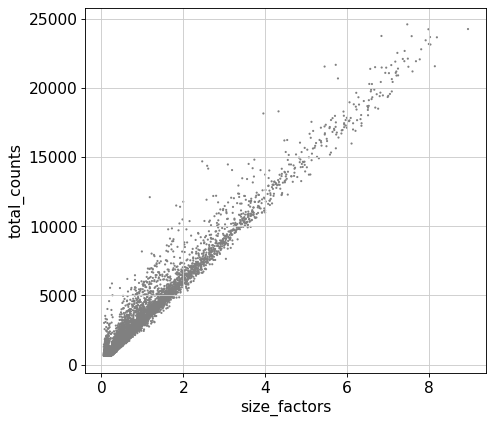

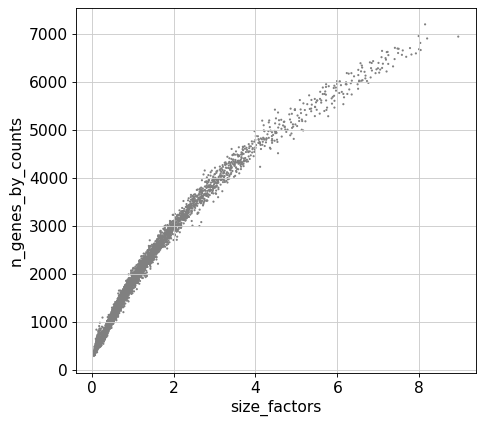

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


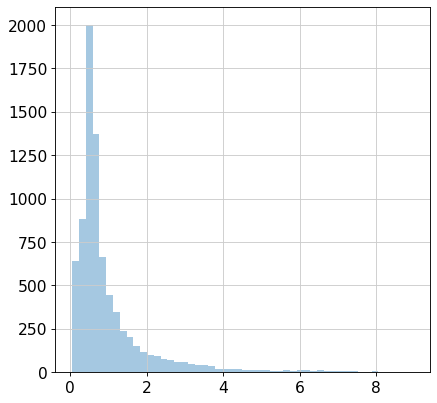

In [27]:
# Visualize the estimated size factors
adata_gex.obs['size_factors'] = size_factors

sc.pl.scatter(adata_gex, 'size_factors', 'total_counts')
sc.pl.scatter(adata_gex, 'size_factors', 'n_genes_by_counts')

sns.distplot(size_factors, bins=50, kde=False)
plt.show()

No size factorss are below 0, and the range of size factors is manageable (not >10, and mostly <4)

In [28]:
#Keep the count data in a counts layer
adata_gex.layers["counts"] = adata_gex.X.copy()

#Normalize adata 
adata_gex.X /= adata_gex.obs['size_factors'].values[:,None]
sc.pp.log1p(adata_gex)

#Transform back into a sparse matrix
adata_gex.X = sp.sparse.csr_matrix(adata_gex.X)

#Store the full data set in 'raw' as log-normalised data for statistical testing
adata_gex.raw = adata_gex

# HVGs

In [29]:
sc.pp.highly_variable_genes(adata_gex, flavor='cell_ranger', n_top_genes=4000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_gex.var['highly_variable'])))


 Number of highly variable genes: 4000


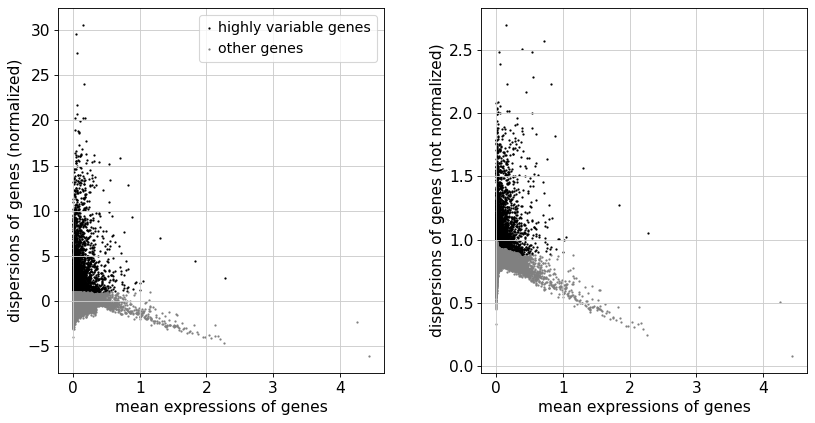

In [30]:
sc.pl.highly_variable_genes(adata_gex)

# Visualization

In [31]:
# Calculate the visualizations
sc.pp.pca(adata_gex, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_gex)
sc.tl.umap(adata_gex)

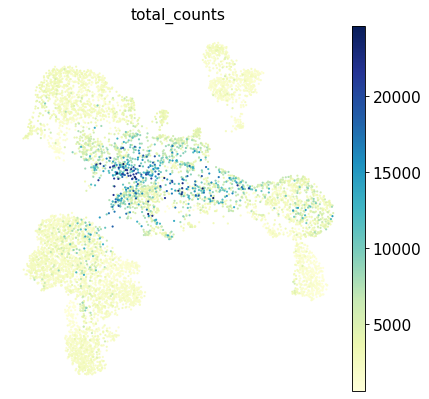

In [32]:
sc.pl.umap(adata_gex, color='total_counts')

We see a high count area aggregated in the middle of the UMAP... this can be problematic, but we can deal with this later as well.

# CC scoring

In [33]:
cc_genes_file = '~/gene_lists/Macosko_cell_cycle_genes.txt'

In [34]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, s_genes)]
g2m_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, g2m_genes)]

sc.tl.score_genes_cell_cycle(adata_gex, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

... storing 'phase' as categorical


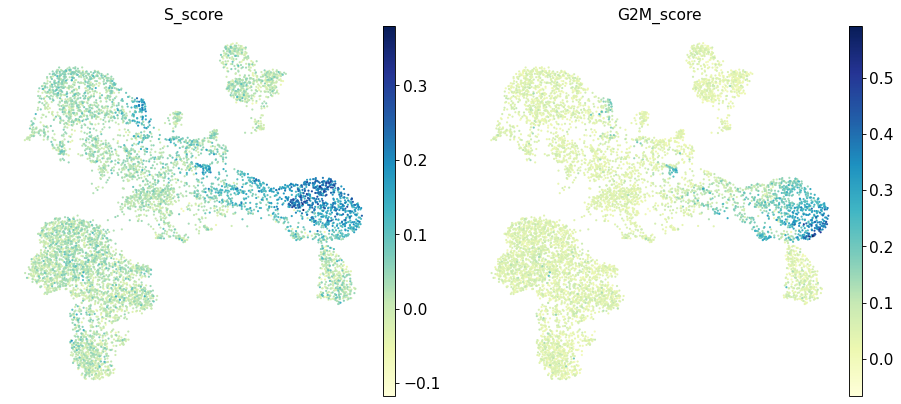

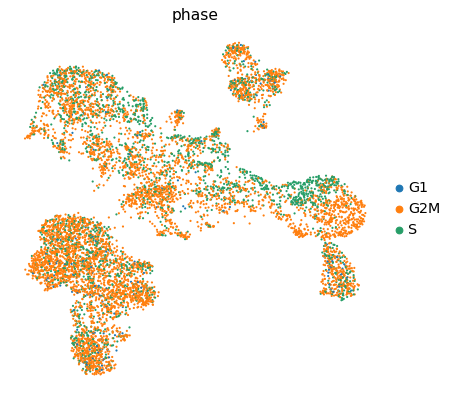

In [35]:
sc.pl.umap(adata_gex, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata_gex, color='phase', use_raw=False)

There is 1 cluster with a clear cell cycle separation, this is likely cycling erythroblasts. This gives the first hint at where the erythrocyte differentiation trajectory is.

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [36]:
sc.tl.leiden(adata_gex, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_gex, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_gex, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_gex, resolution=1, key_added='leiden_res1')

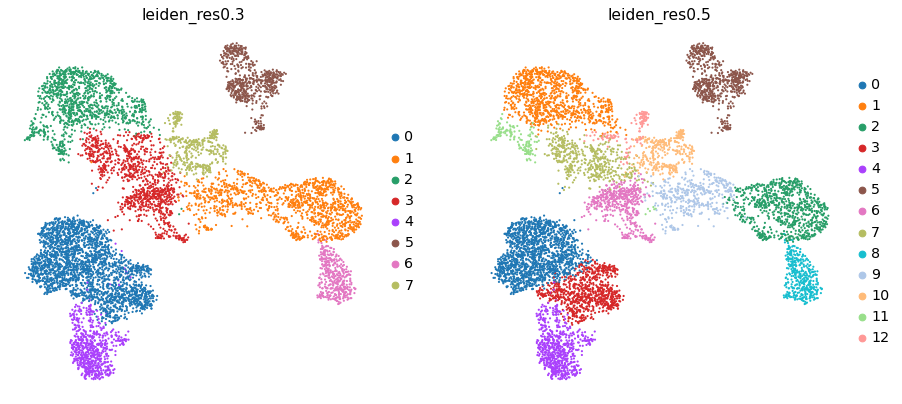

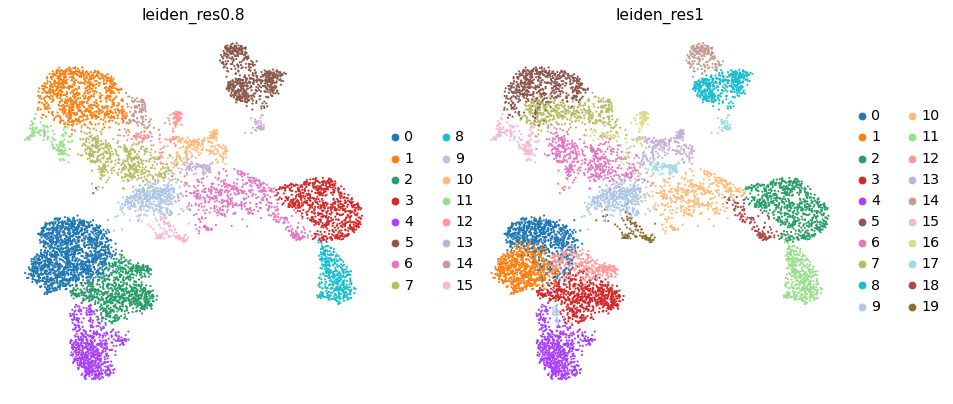

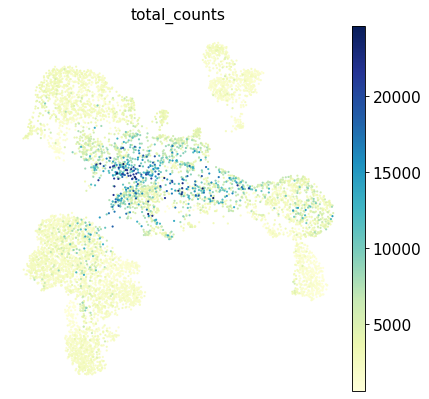

In [37]:
sc.pl.umap(adata_gex, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_gex, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_gex, color='total_counts')

Check which clusters have the problematic aggregation of high-count cells... these might be difficult to annotate and could be doublets.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).

In [38]:
test_dat = adata_gex.copy()
test_dat.X = adata_gex.raw.X

In [39]:
sc.external.pp.scrublet(test_dat)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 1.6%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 4.6%


In [40]:
sc.external.pl.scrublet_score_distribution(test_dat)

(<Figure size 640x240 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

The distribution of simulated doublets show that potentially a score over 0.25 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [41]:
adata_gex.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_gex.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [42]:
del test_dat

... storing 'predicted_doublet' as categorical


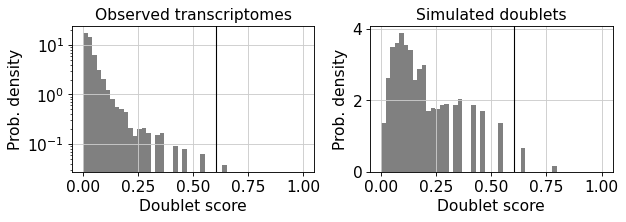

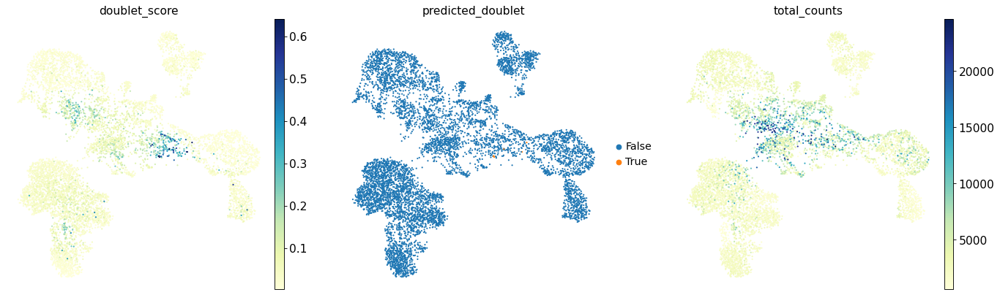

In [43]:
sc.pl.umap(adata_gex, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker genes

In [44]:
marker_genes = {
    'CD14+ Mono': ['FCN1', 'CD14'],
    'CD16+ Mono': ['TCF7L2', 'FCGR3A', 'LYN'],
    'ID2-hi myeloid prog': ['CD14', 'ID2', 'VCAN', 'S100A9', 'CLEC12A', 'KLF4', 'PLAUR'],
    'cDC1': ['CLEC9A', 'CADM1'],
    'cDC2': ['CLEC10A', 'FCER1A', 'CST3', 'COTL1', 'LYZ', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'],
    'Erythroblast': ['MKI67', 'HBA1', 'HBB'],
    'Proerythroblast': ['CDK6', 'SYNGR1', 'HBM', 'GYPA'], # Note HBM and GYPA are negative markers
    'NK': ['GNLY', 'NKG7', 'CD247', 'GRIK4', 'FCER1G', 'TYROBP', 'KLRG1', 'FCGR3A'],
    'ILC': ['ID2', 'PLCG2', 'GNLY', 'SYNE1'],
    'Lymph prog': ['IGLL1', 'VPREB1', 'MME', 'EBF1', 'SSBP2', 'BACH2', 'CD79B', 'IGHM', 'PAX5', 'PRKCE', 'DNTT'],
    'Naive CD20+ B': ['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM'],
    'B1 B': ['MS4A1', 'SSPN', 'ITGB1', 'EPHA4', 'COL4A4', 'PRDM1', 'ZNF215', 'IRF4', 'CD38', 'XBP1', 'PAX5', 'BCL11A', 'BLK', 'IGHD', 'IGHM'], # Note IGHD and IGHM are negative markers
    'Transitional B': ['MME', 'CD38', 'CD24', 'ACSM3', 'MSI2'],
    'Plasma cells': ['MZB1', 'HSP90B1', 'FNDC3B', 'PRDM1', 'IGKC', 'JCHAIN'],
    'Plasmablast': ['XBP1', 'RF4', 'PRDM1', 'PAX5'],  # Note PAX5 is a negative marker
    'CD4+ T activated': ['CD4', 'IL7R', 'TRBC2', 'ITGB1'],
    'CD4+ T naive': ['CD4', 'IL7R', 'TRBC2', 'CCR7'],
    'CD8+ T': ['CD8A', 'CD8B', 'GZMB', 'GZMA', 'CCL5', 'GZMK', 'GZMH', 'GZMA'],
    'T activation': ['CD69', 'CD38'], # CD69 much better marker!
    'T naive': ['LEF1', 'CCR7', 'TCF7'],
    'pDCs': ['GZMB', 'IL3RA', 'COBLL1', 'TCF4'],
    'G/M prog': ['MPO', 'BCL2', 'KCNQ5', 'CSF3R', 'PRTN3'],
    'HSC': ['NRIP1', 'MECOM', 'PROM1', 'CD34', 'NKAIN2'],
    'MK/E prog': ['ZNF385D', 'ITGA2B', 'RYR3', 'PLCB1'] # Note PLCB1 is a negative marker
}


In [45]:
sc.tl.rank_genes_groups(adata_gex, groupby='leiden_res0.5', key_added='rank_genes_res0.5')

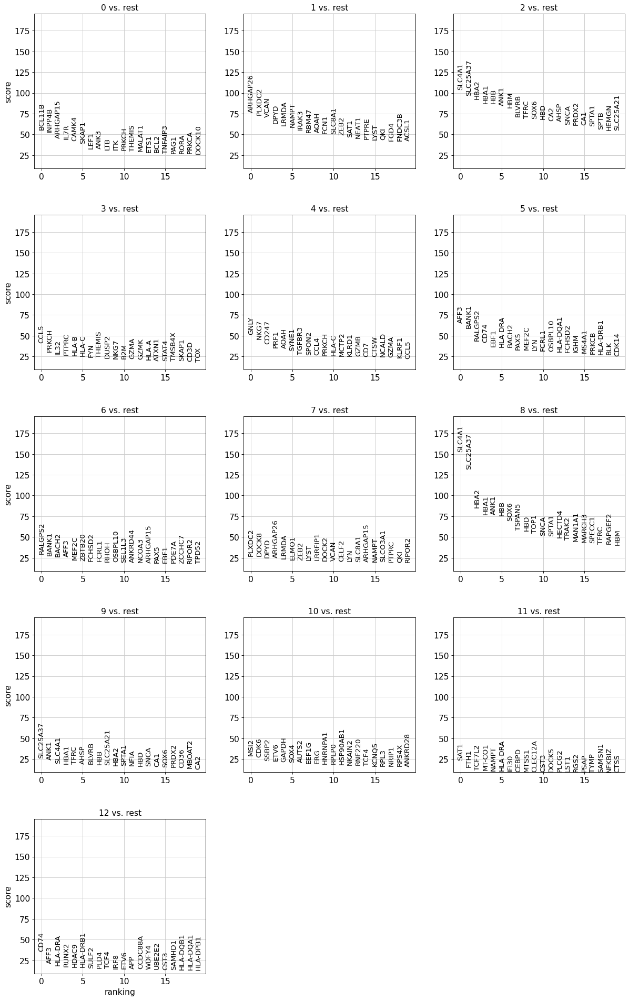

In [46]:
sc.pl.rank_genes_groups(adata_gex, key='rank_genes_res0.5', ncols=3, fontsize=12)

## Literature markers

In [47]:
from matplotlib import colors

In [48]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [49]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_gex, reference_markers=marker_genes, key='rank_genes_res0.5'), annot=True)

<AxesSubplot:>

First overview of clusters suggests:
- 0: CD4+ T cells
- 1: CD14+ Monocytes or cDC2
- 2: Erythrocyte development
- 3: CD8+ T / NK
- 4: NK / ILC
- 5: B cells / lymph prog.
- 6: B cells / lymph prog.
- 7: -
- 8: Erythrocyte development
- 9: Erythrocyte development
- 10: Progenitors
- 11: CD16 + Monocytes, or CD14+Monocytes, cDC2, or ILC
- 12: pDCs / cDC2

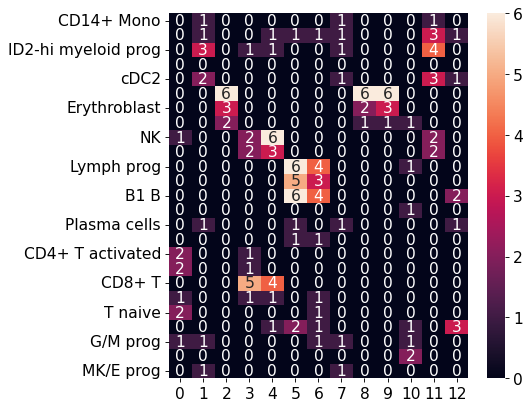

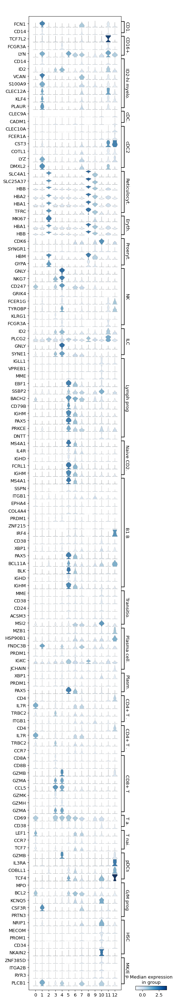

In [50]:
# Look at the marker genes in a concise manner
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_gex.var_names]
    filt_marker_genes[key] = filt_vals

adata_plot = adata_gex.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes, groupby='leiden_res0.5', use_raw=False, swap_axes=True)

Cluster: CD14+ Mono


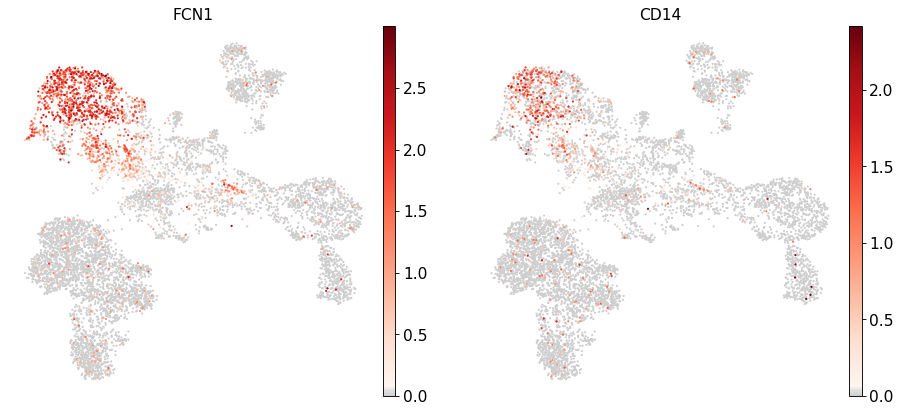

Cluster: CD16+ Mono


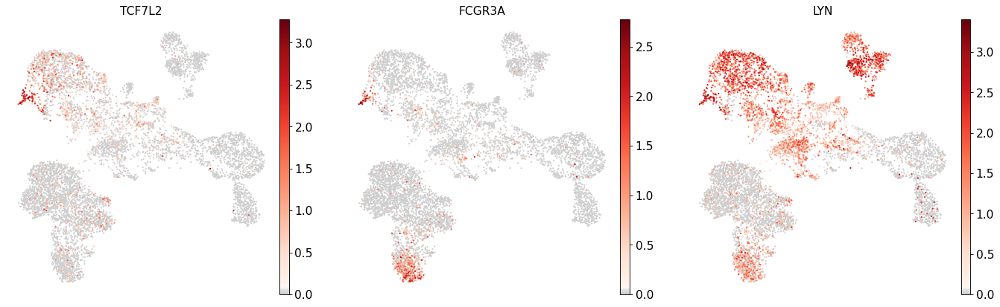

Cluster: ID2-hi myeloid prog


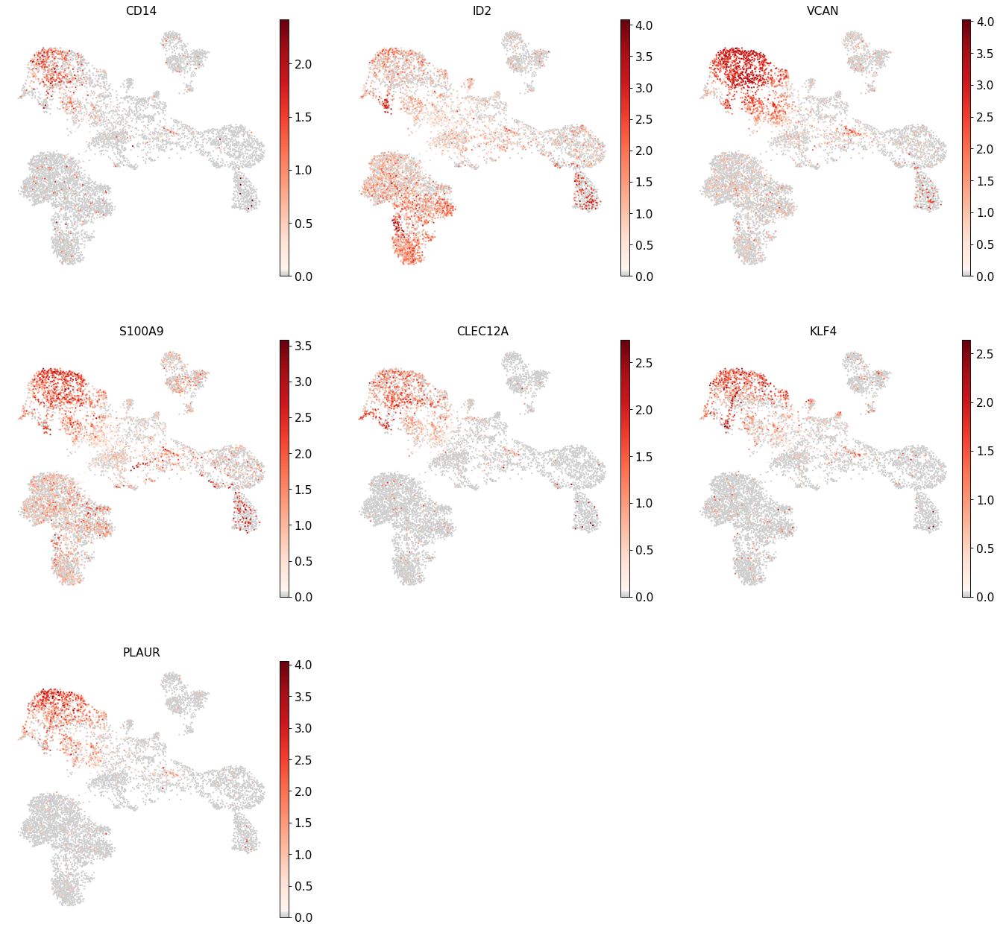

Cluster: cDC1


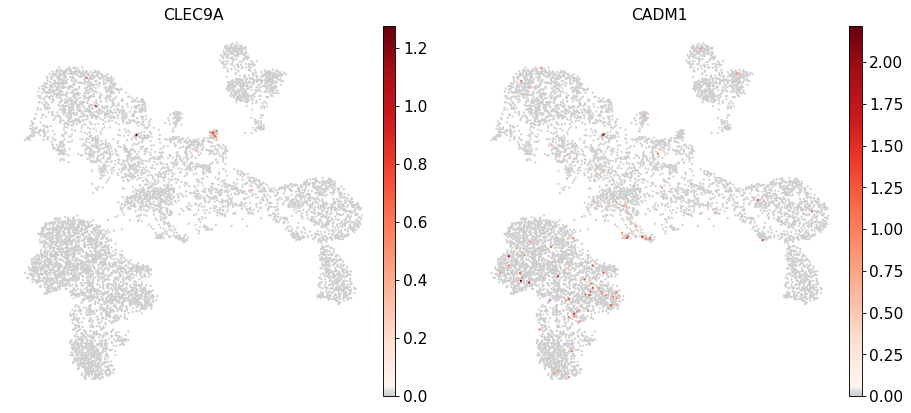

Cluster: cDC2


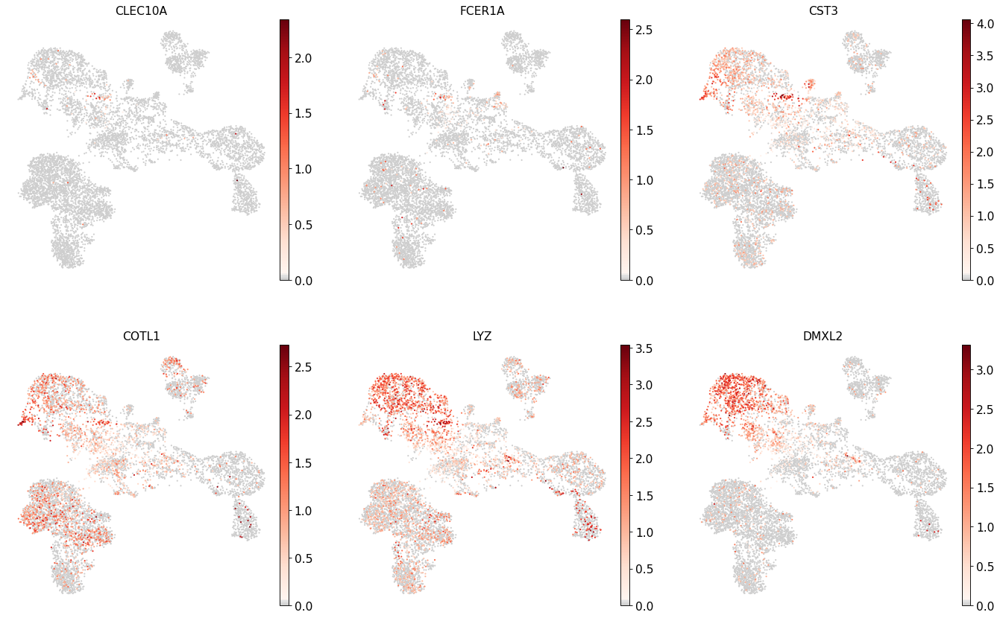

Cluster: Reticulocyte


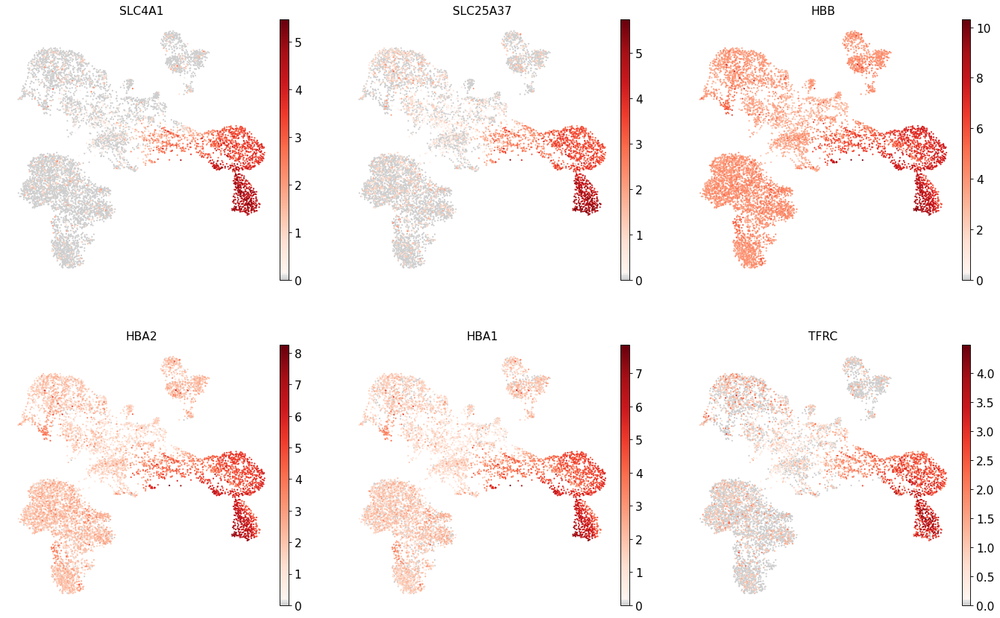

Cluster: Erythroblast


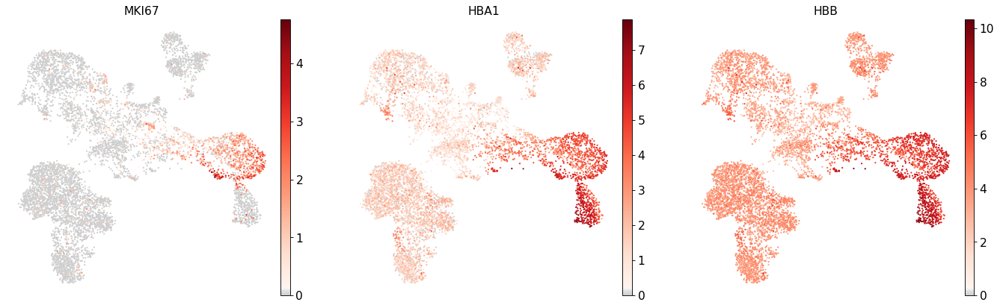

Cluster: Proerythroblast


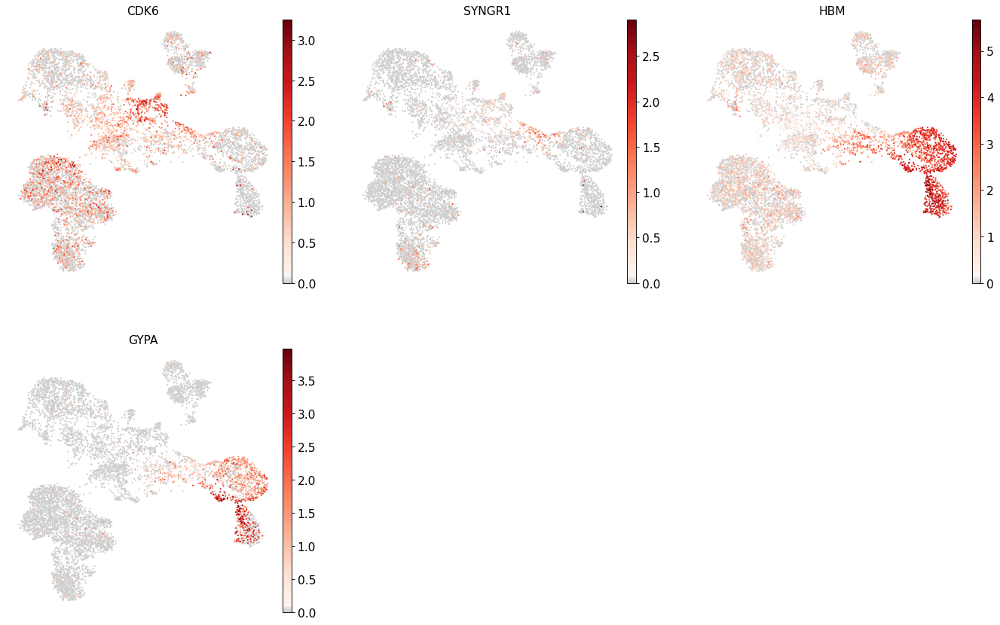

Cluster: NK


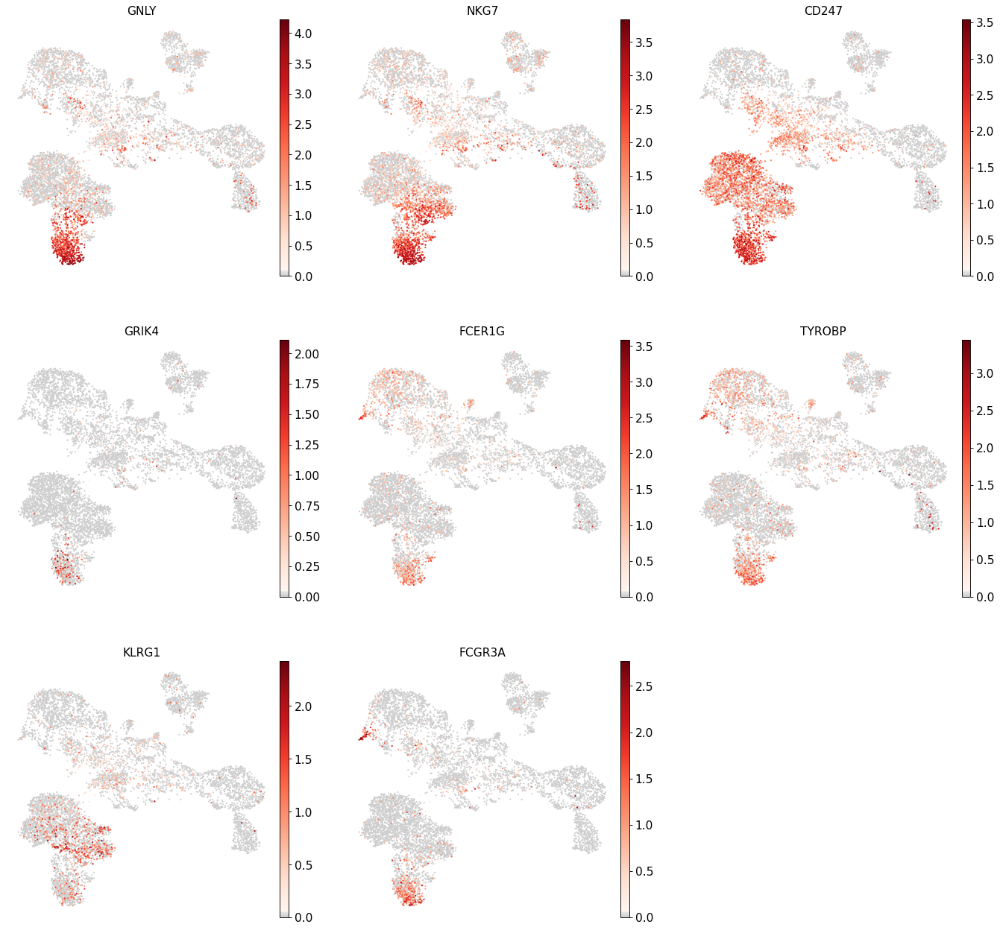

Cluster: ILC


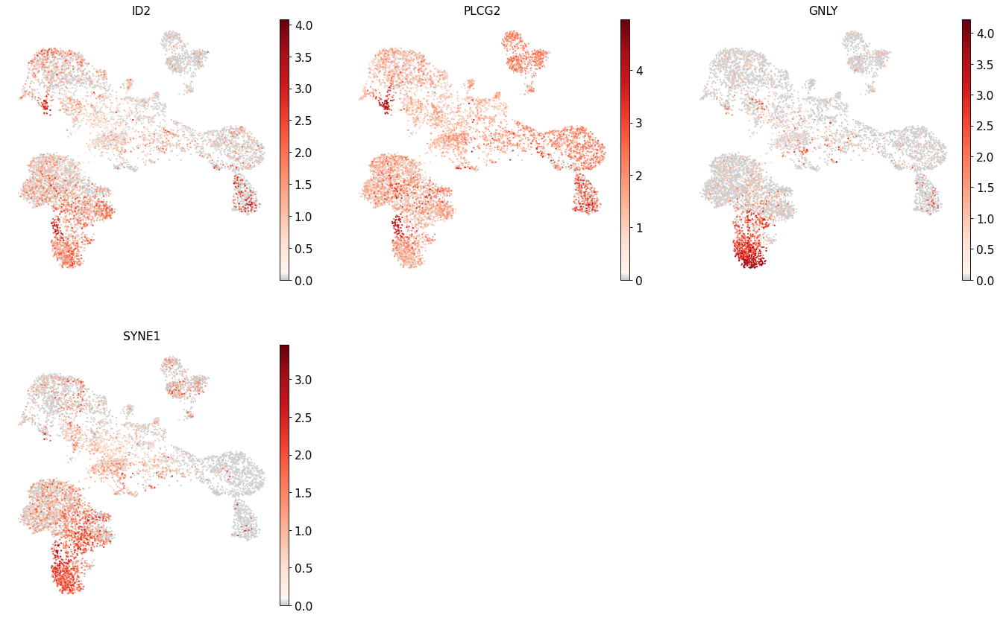

Cluster: Lymph prog


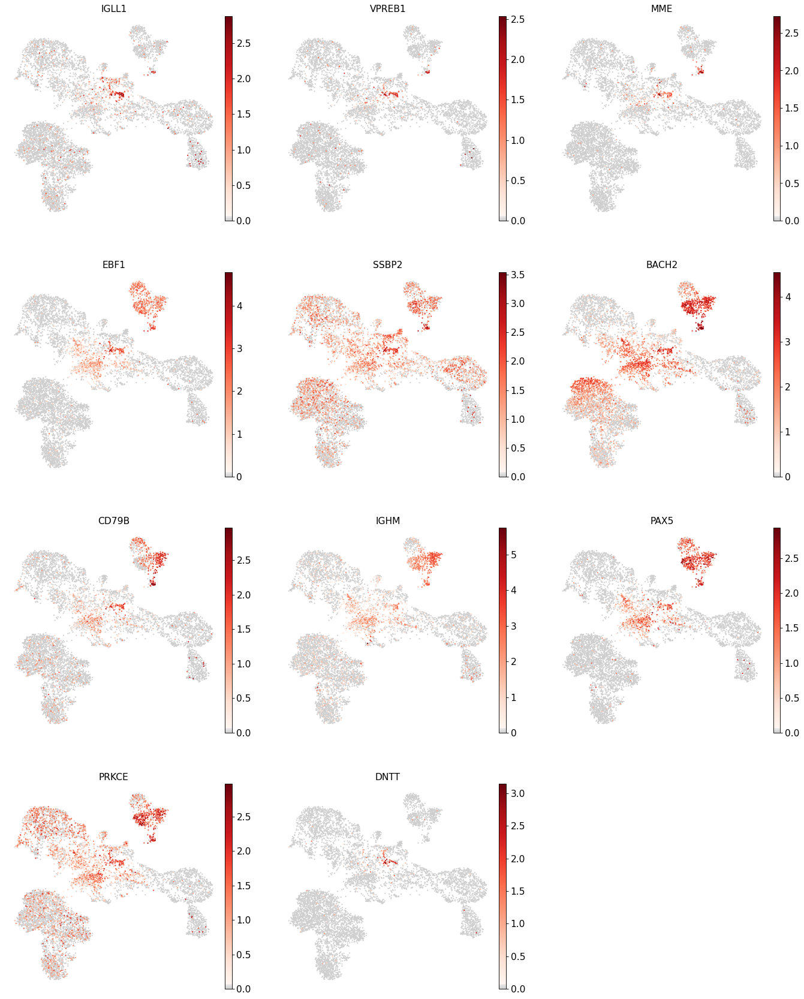

Cluster: Naive CD20+ B


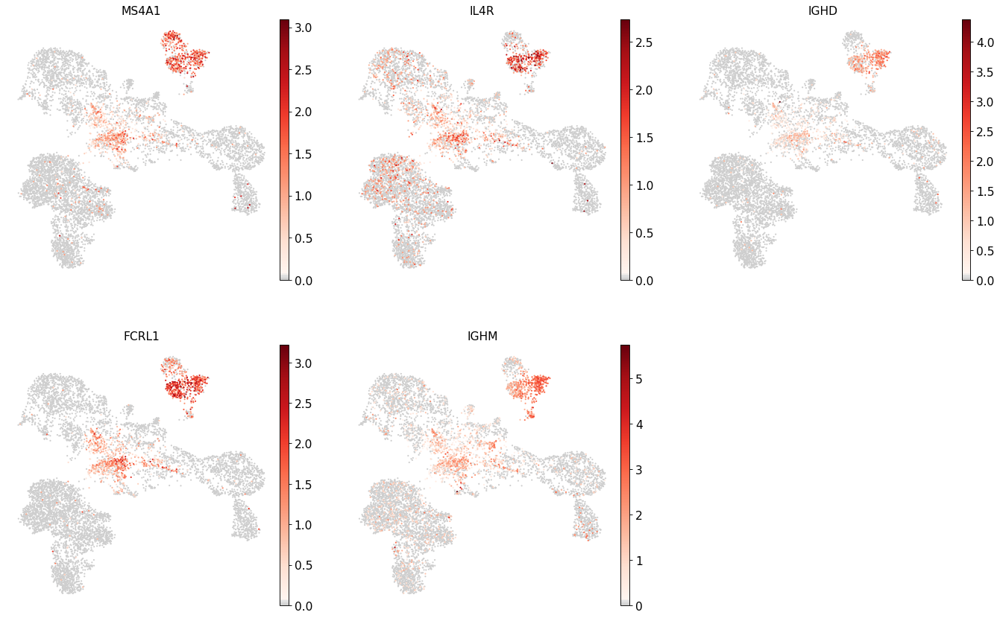

Cluster: B1 B


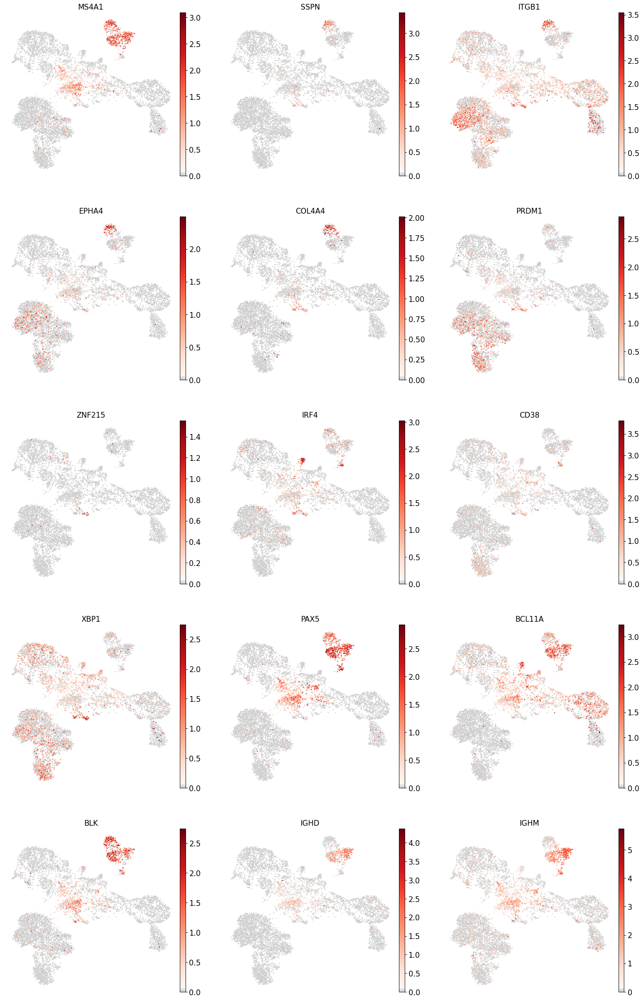

Cluster: Transitional B


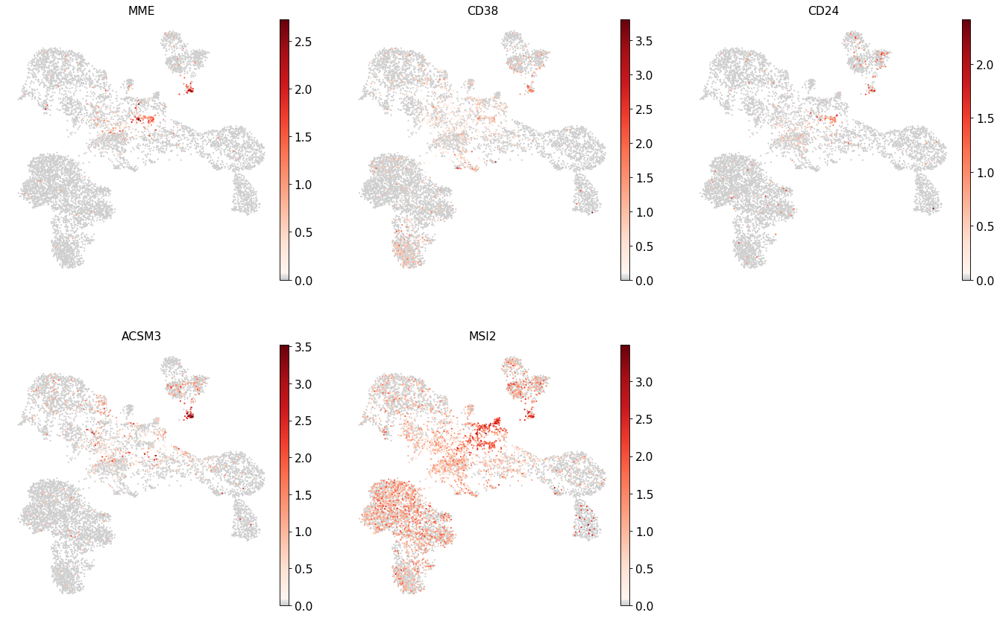

Cluster: Plasma cells


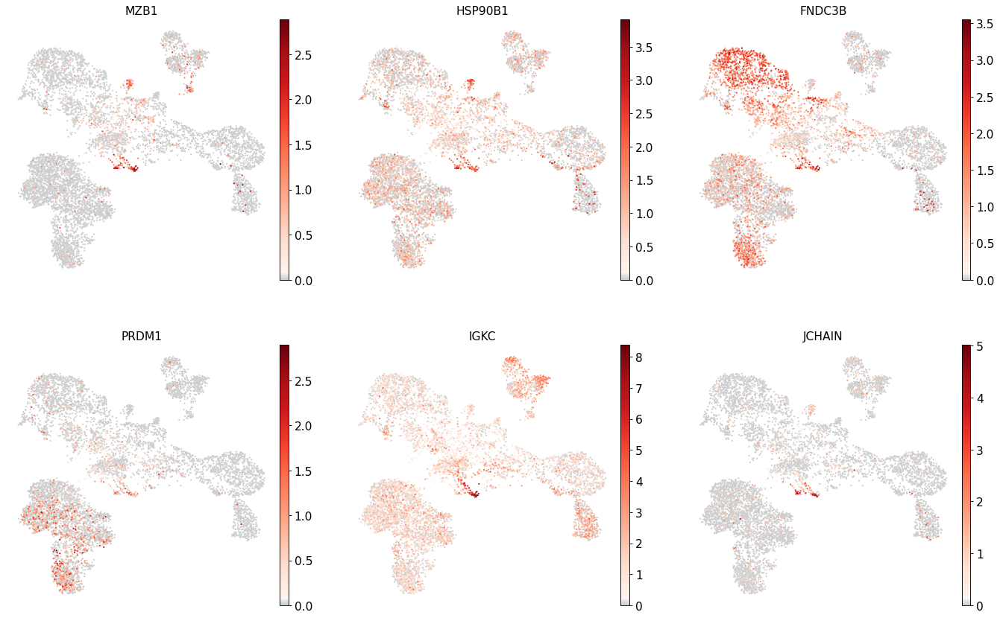

Cluster: Plasmablast


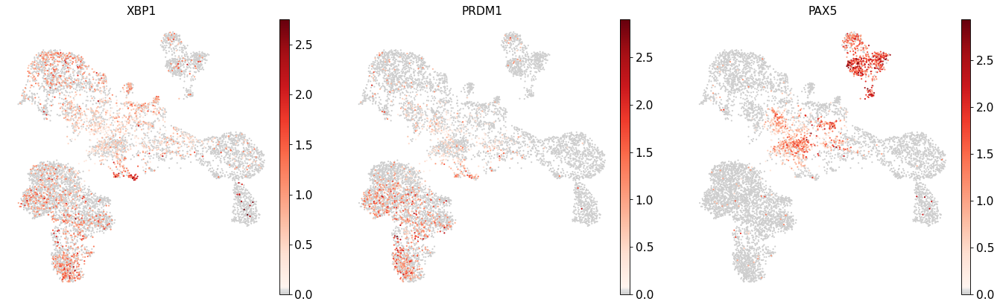

Cluster: CD4+ T activated


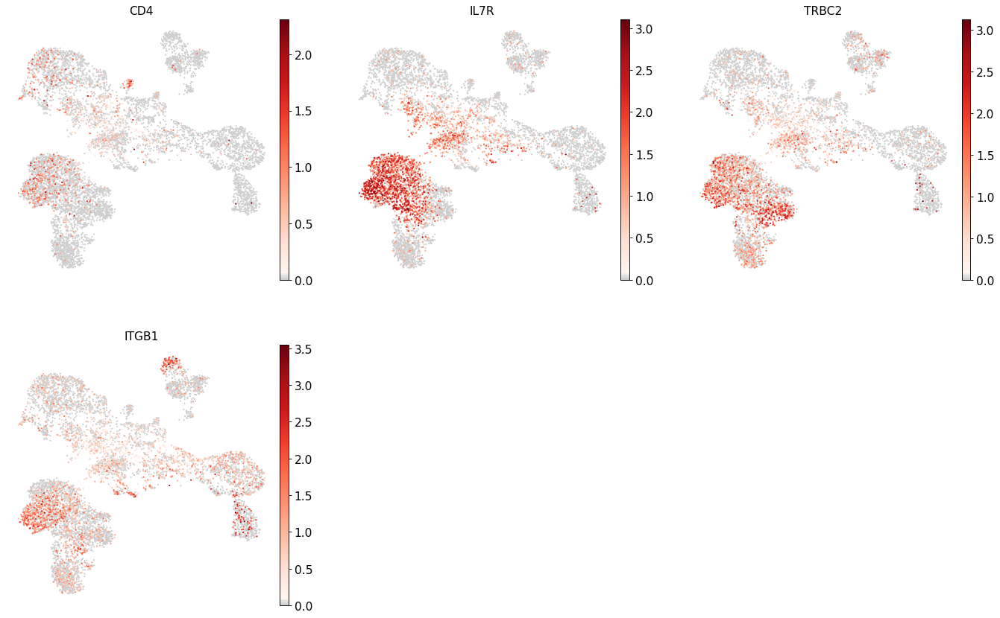

Cluster: CD4+ T naive


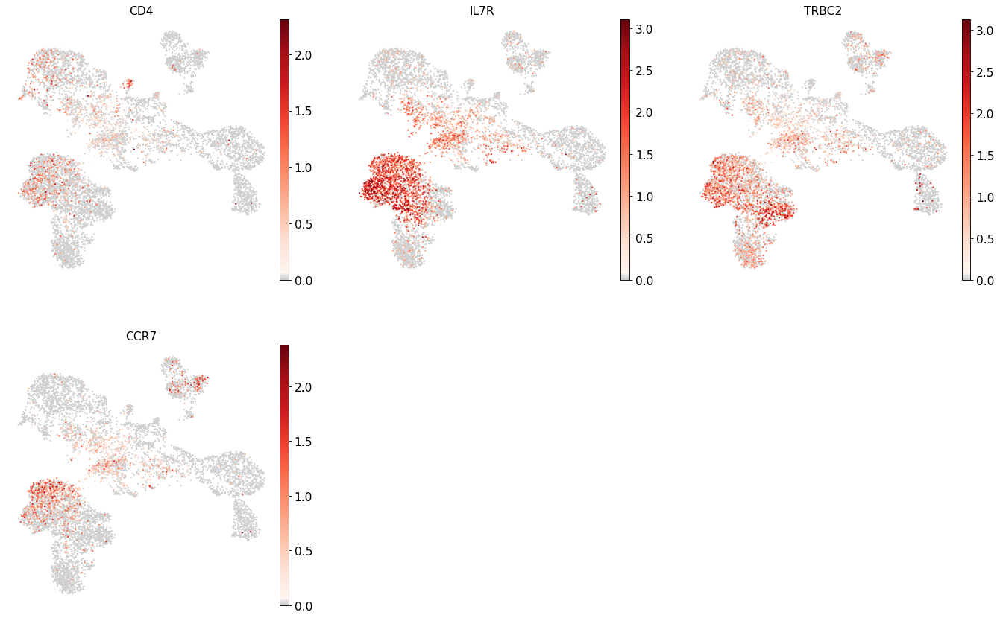

Cluster: CD8+ T


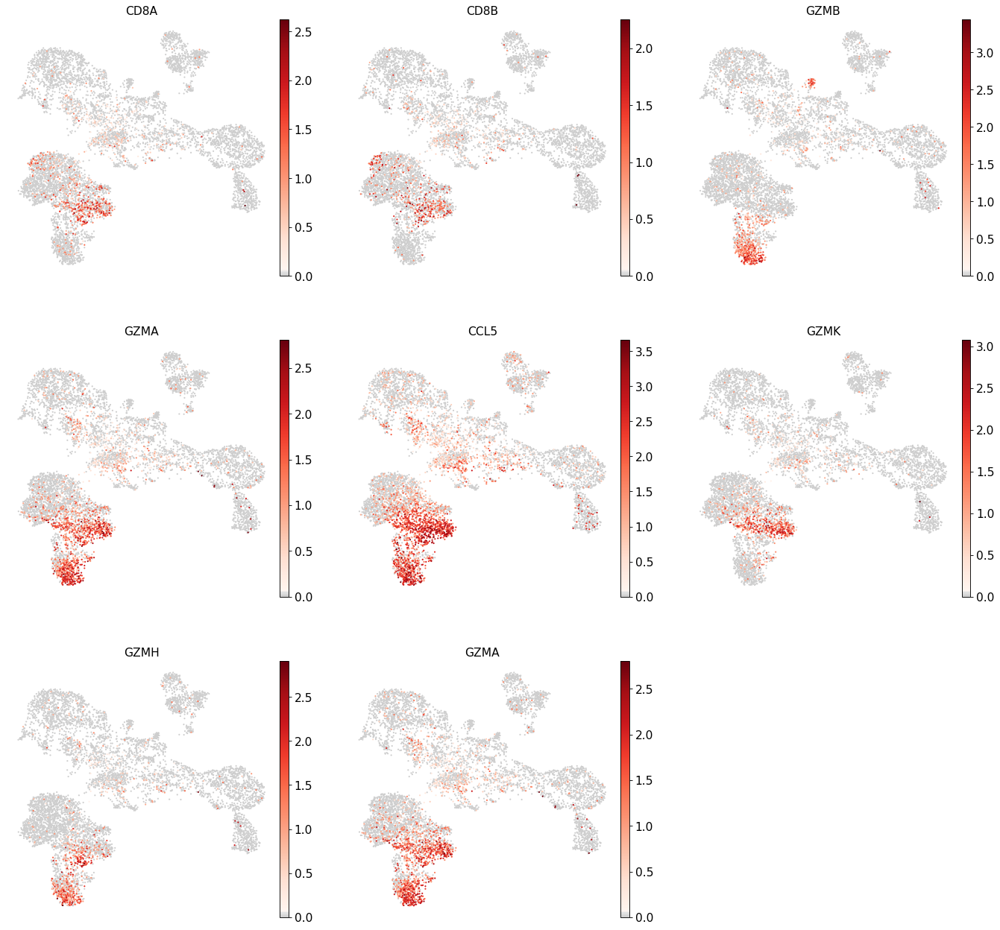

Cluster: T activation


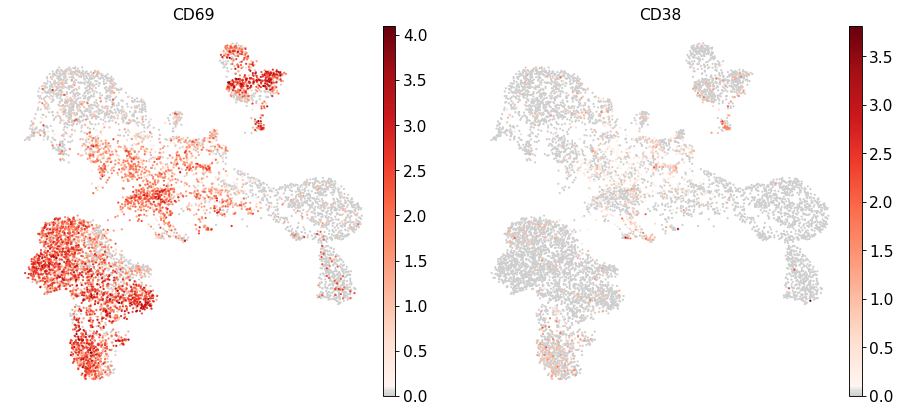

Cluster: T naive


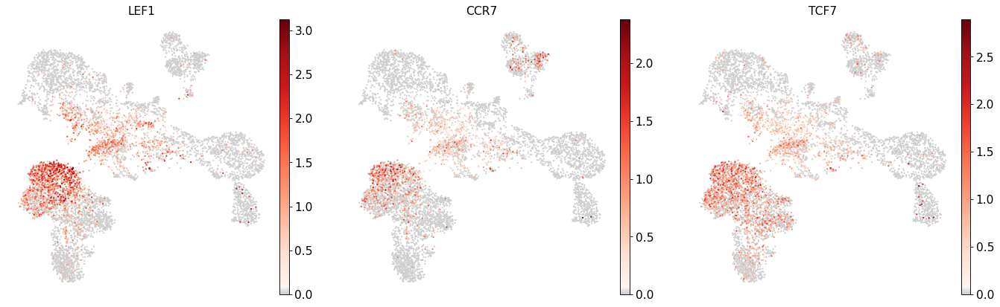

Cluster: pDCs


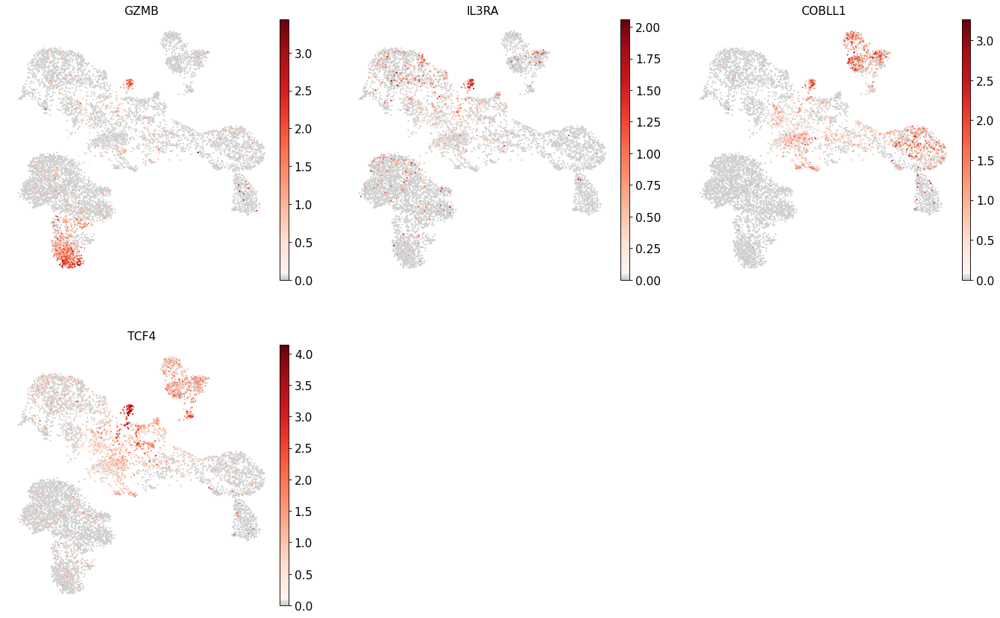

Cluster: G/M prog


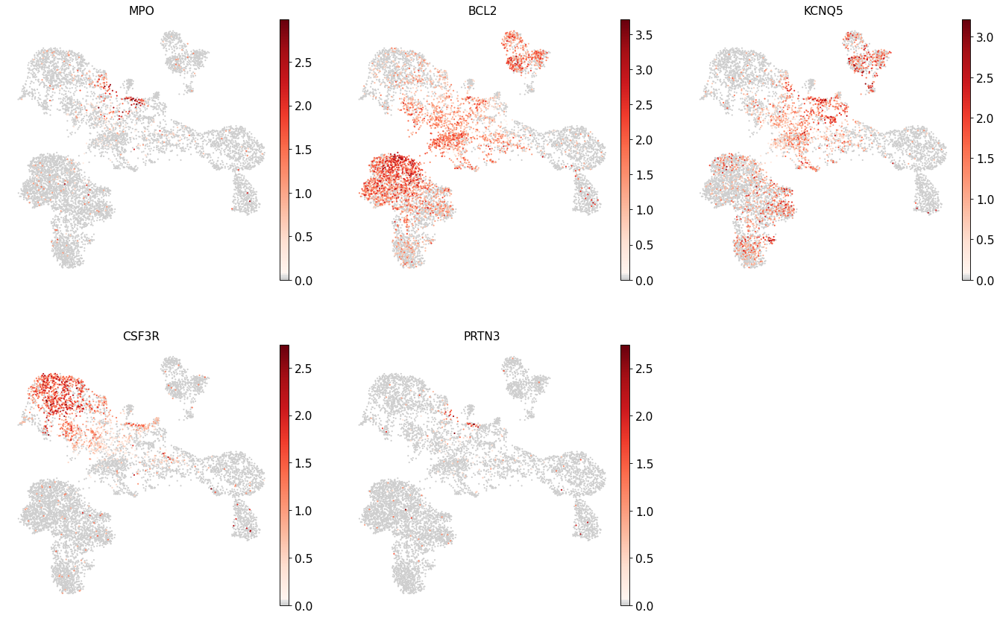

Cluster: HSC


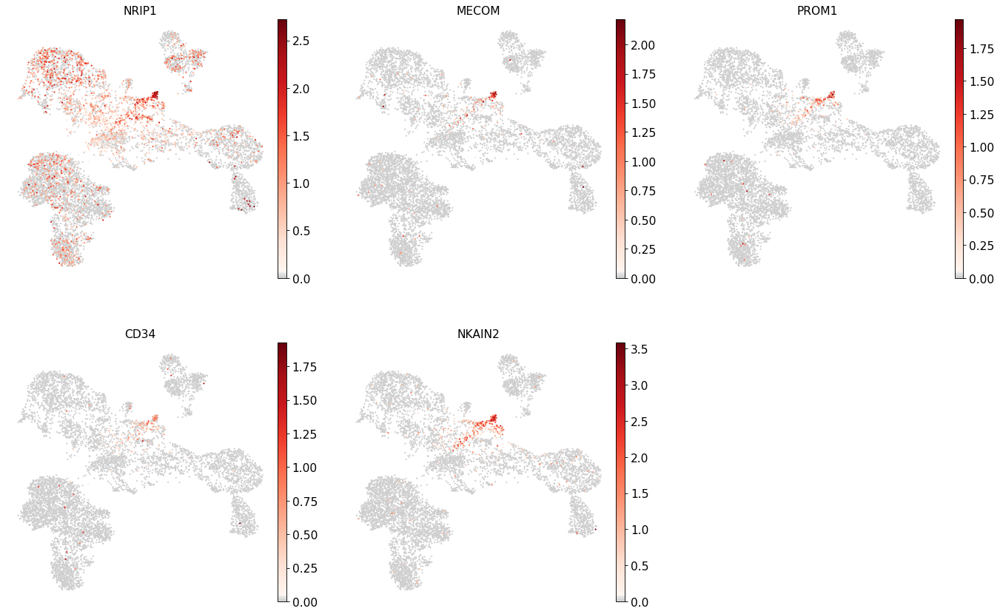

Cluster: MK/E prog


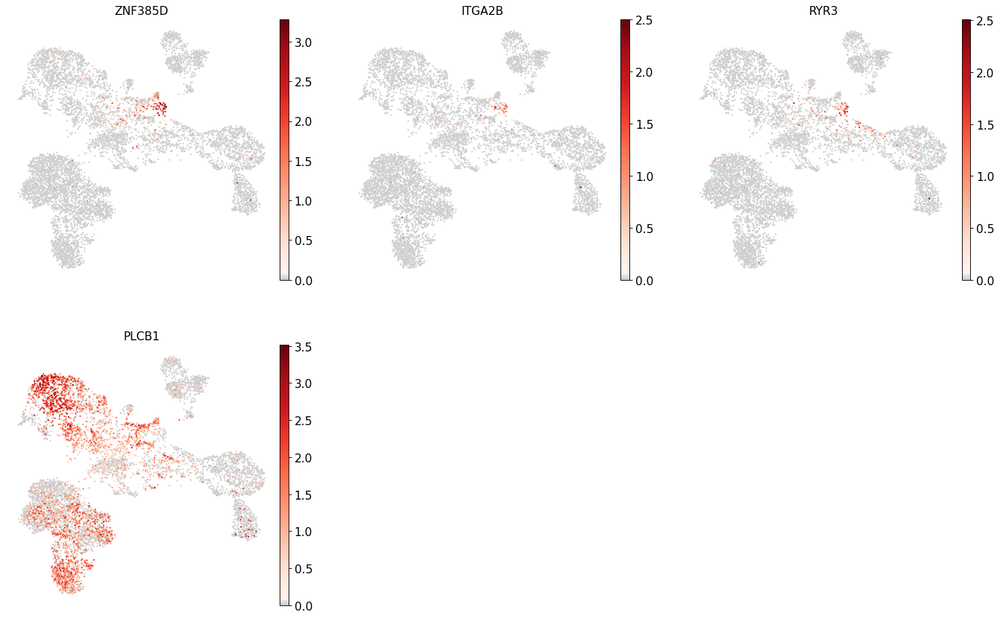

In [51]:
# Look at marker expression 
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_gex.var_names]
    sc.pl.umap(adata_gex, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

Marker genes suggest:
- 0: CD4+ T cells
- 1: CD14+ Monocytes or cDC2
- 2: Erythrocyte development (reticulocytes + erythroblasts + proerythroblasts)
- 3: CD8+ T / NK
- 4: NK / ILC
- 5: B cells / lymph prog.
- 6: B cells / lymph prog.
- 7: -
- 8: Erythrocyte development
- 9: Erythrocyte development
- 10: Progenitors
- 11: CD16 + Monocytes, or CD14+Monocytes, cDC2, or ILC
- 12: pDCs / cDC2

Sub-clustering

Based on the UMAP above, we will sub-cluster the clusters that seem to have sub-structures, or multiple cell identities 
- 11: especially sub-cluster with the resolution that will separate out the SYNGR1 population
- 12: pDC or cDC2
- 2: erythrocyte development
- 5: B cell population
- 1
- 6
- 7
- 9: erythrocyte development (play with the resolution to isolate the very top part)

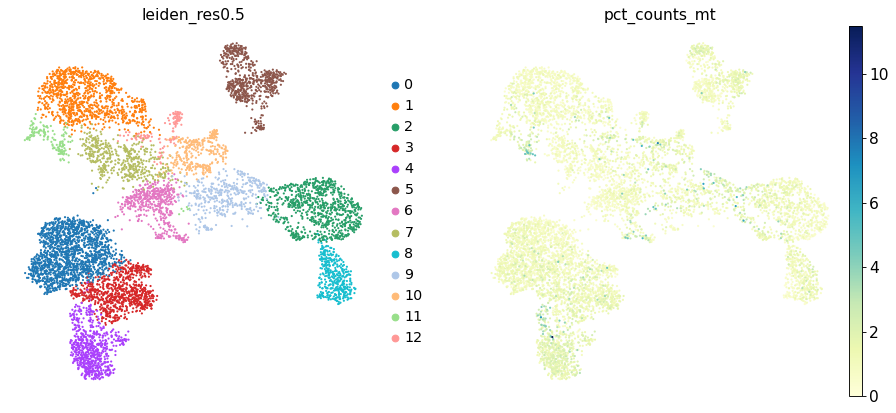

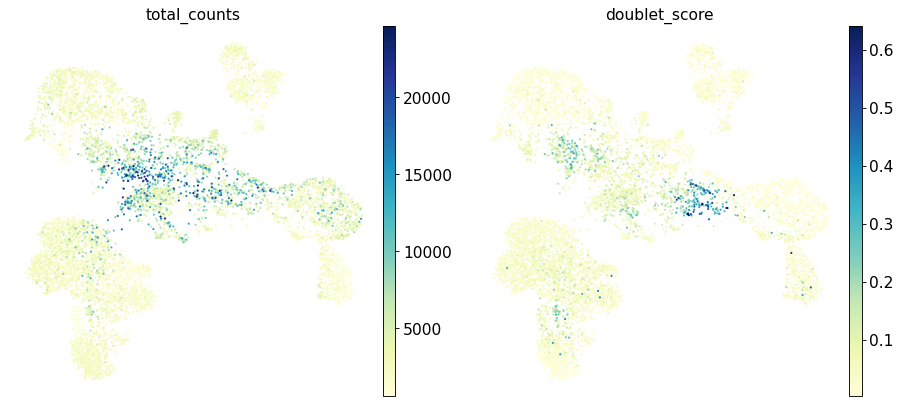

In [52]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_gex, color=['leiden_res0.5', 'pct_counts_mt'])
sc.pl.umap(adata_gex, color=['total_counts', 'doublet_score'])

The doublet score seems to be more apparent in clusters 7 and 9, thus those are potentially doublets.

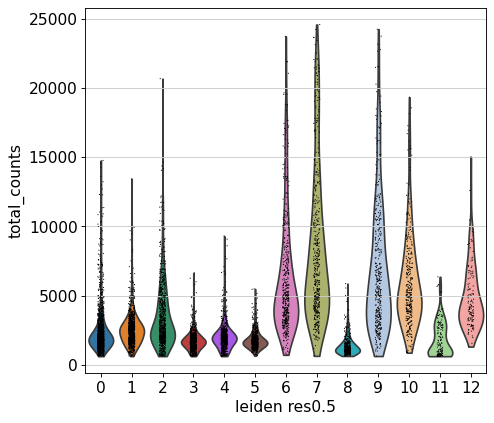

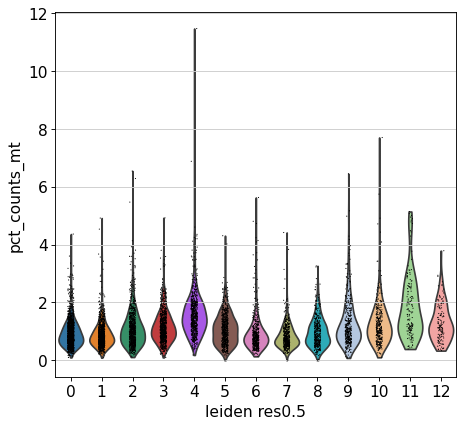

In [53]:
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.5')
sc.pl.violin(adata_gex, keys='pct_counts_mt', groupby='leiden_res0.5')

Clusters 6, 7, and 9 are potentially doublets

Marker genes suggest:
- 0: CD4+ T cells
- 1: CD14+ Monocytes or cDC2
- 2: Erythrocyte development (reticulocytes + erythroblasts + proerythroblasts) -> cycling cells
- 3: CD8+ T / NK
- 4: NK / ILC
- 5: B cells / lymph prog.
- 6: B cells / lymph prog.
- 7: -
- 8: Erythrocyte development
- 9: Erythrocyte development
- 10: Progenitors
- 11: CD16 + Monocytes, or CD14+Monocyte progenitors, cDC2, or ILC
- 12: pDCs / cDC2

Sub-clustering

Based on the UMAP above, we will sub-cluster the clusters that seem to have sub-structures, or multiple cell identities 
- 0: naive vs activated T cells
- 11: especially sub-cluster with the resolution that will separate out the SYNGR1 population
- 12: pDC or cDC2
- 2: erythrocyte development
- 5: B cell population
- 1
- 6: plasma cells or also other sub-structures?
- 7: confusing cluster
- 9: erythrocyte development (play with the resolution to isolate the very top part)

Note. Clusters 6,7, and 9 are likely doublets, which we need to check further later using gene expression features for the genes that are often differentially expressed in doublets.

Note. Cluster 8 could be sub-clustered for further analyses, but I'm leaving it here just as it is, as I didn't see a clear sub-structure here.

# Subclustering

## T cells - cluster 0

### Cluster 0

In [54]:
orig_key = 'leiden_res0.5'
new_key = 'leiden_res0.5_tsub'
new_rg_key = 'rg_res0.5_tsub'
sub_key = '0'

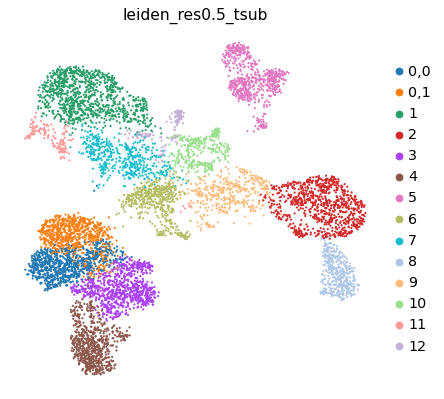

1      991
2      830
0,0    826
3      818
0,1    763
4      693
5      640
6      483
7      481
8      401
9      399
10     327
11     149
12     130
Name: leiden_res0.5_tsub, dtype: int64

In [55]:
sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.5', [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)

#sc.tl.leiden(adata_gex, restrict_to=('leiden_res0.5', [sub_key]), key_added=new_key, resolution=0.1)
#sc.pl.umap(adata_gex, color=new_key)

adata_gex.obs[new_key].value_counts()

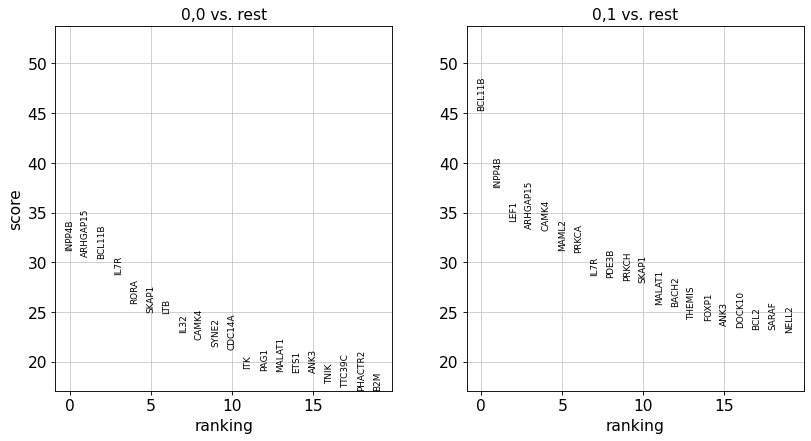

In [56]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

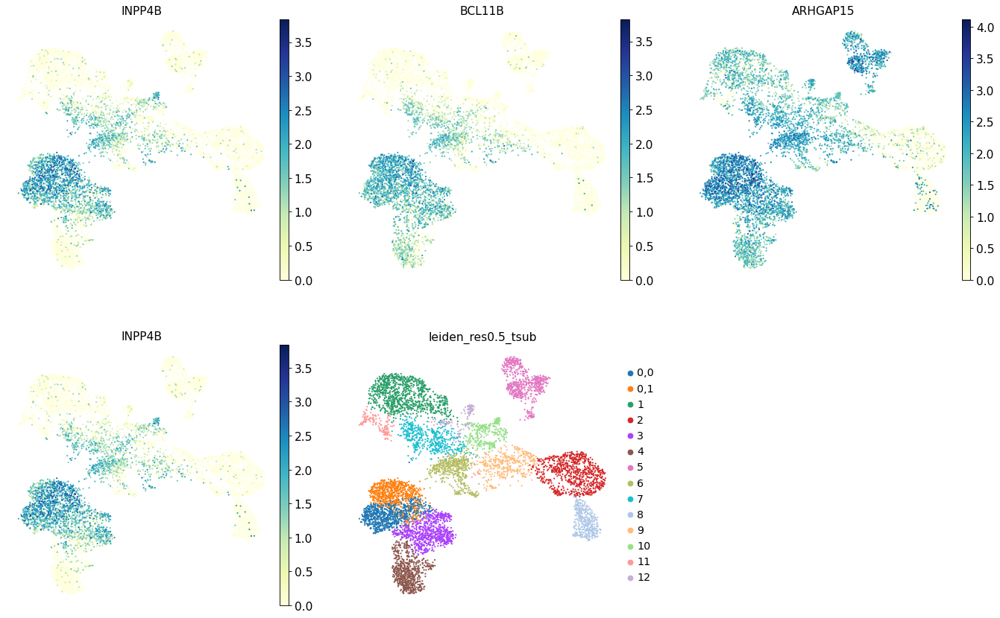

In [57]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

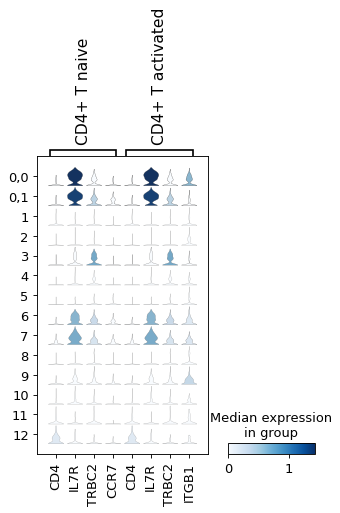

In [58]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD4+ T naive','CD4+ T activated']}, groupby=new_key)

Looks like 0,0 is closer to CD4+ activated and 0,1 is more CD4+ naive (from the ITGB1)

### Summary

- CD4+ T cell subtypes:
  - 0,0: CD4+ T activated
  - 0,1: CD4+ T naive

## Monocytes & DCs - clusters 1, 11, and 12

### Cluster 1

This is here to show when to decide against subclustering!

In [59]:
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_msub'
new_rg_key = 'rg_res0.5_msub'
sub_key = '1'

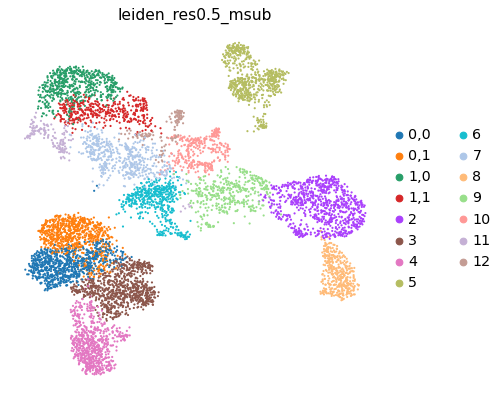

2      830
0,0    826
3      818
0,1    763
4      693
5      640
1,0    573
6      483
7      481
1,1    418
8      401
9      399
10     327
11     149
12     130
Name: leiden_res0.5_msub, dtype: int64

In [60]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.15)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

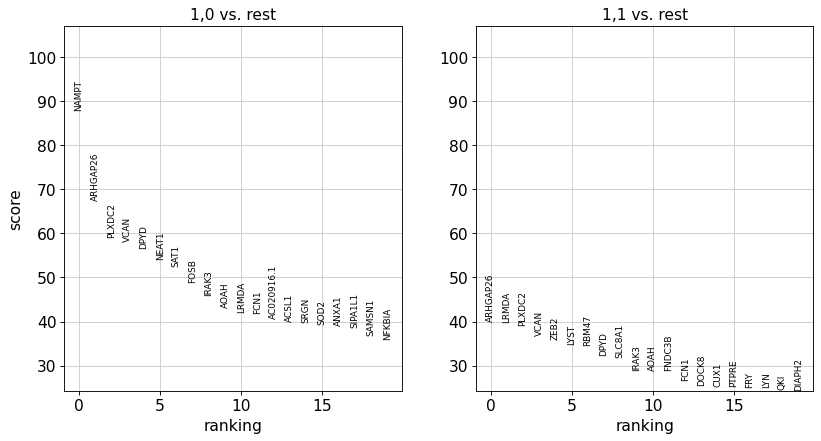

In [61]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

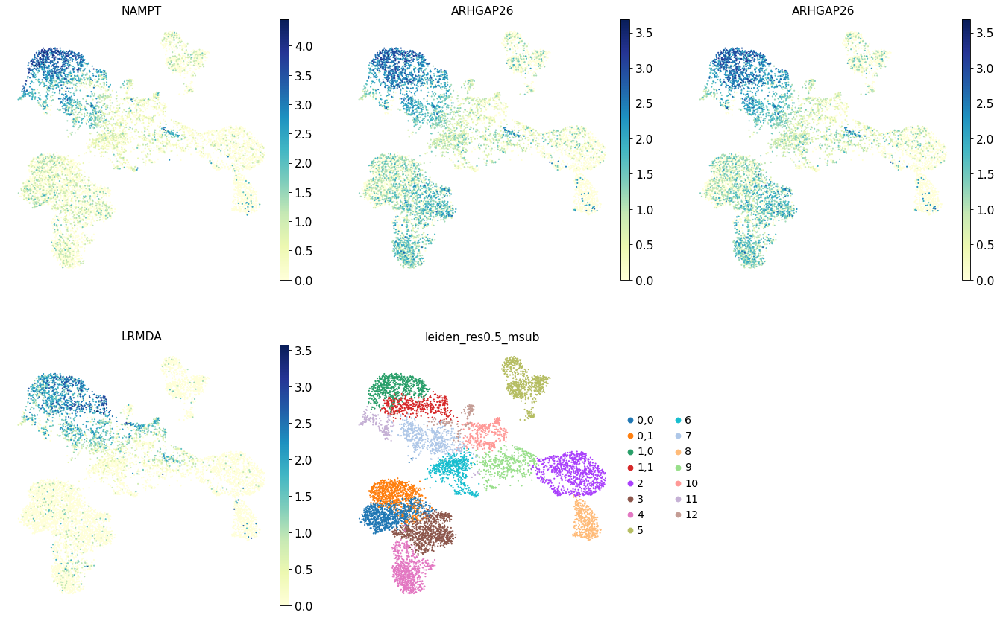

In [62]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [63]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

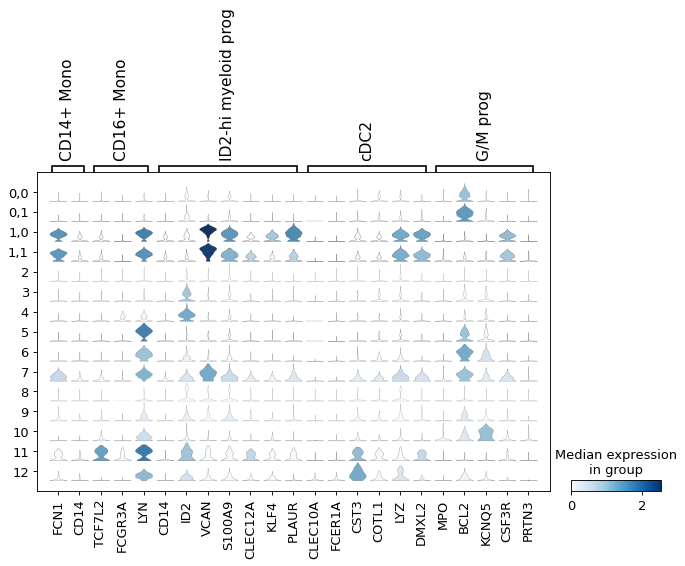

In [64]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono','CD16+ Mono', 'ID2-hi myeloid prog', 
                                                                       'cDC2', 'G/M prog']}, groupby=new_key)

No notable marker gene differences in cluster 1. There are only some gradients, which we can leave here.

### Cluster 11

In [65]:
# ignore the previous sub-clustering with the key 'leiden_res0.5_msub', and instead use 'leiden_res0.5_tsub'.
orig_key = 'leiden_res0.5_tsub'
new_key = 'leiden_res0.5_msub2'
new_rg_key = 'rg_res0.5_msub2'
sub_key = '11'

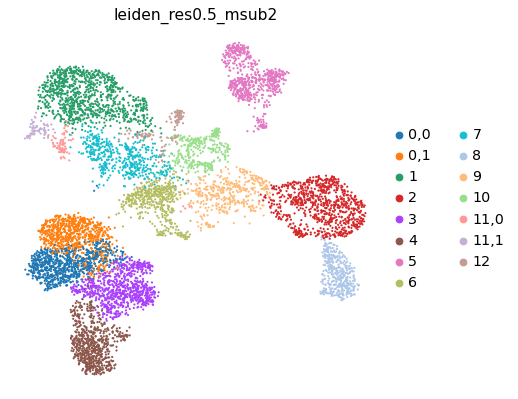

1       991
2       830
0,0     826
3       818
0,1     763
4       693
5       640
6       483
7       481
8       401
9       399
10      327
12      130
11,0     76
11,1     73
Name: leiden_res0.5_msub2, dtype: int64

In [66]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

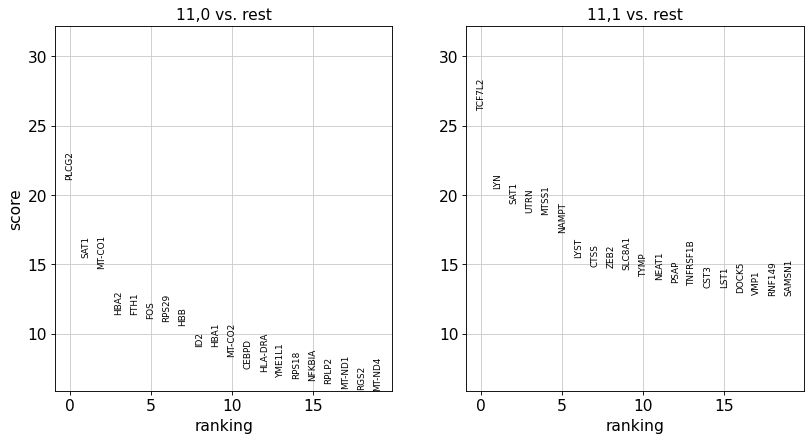

In [67]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

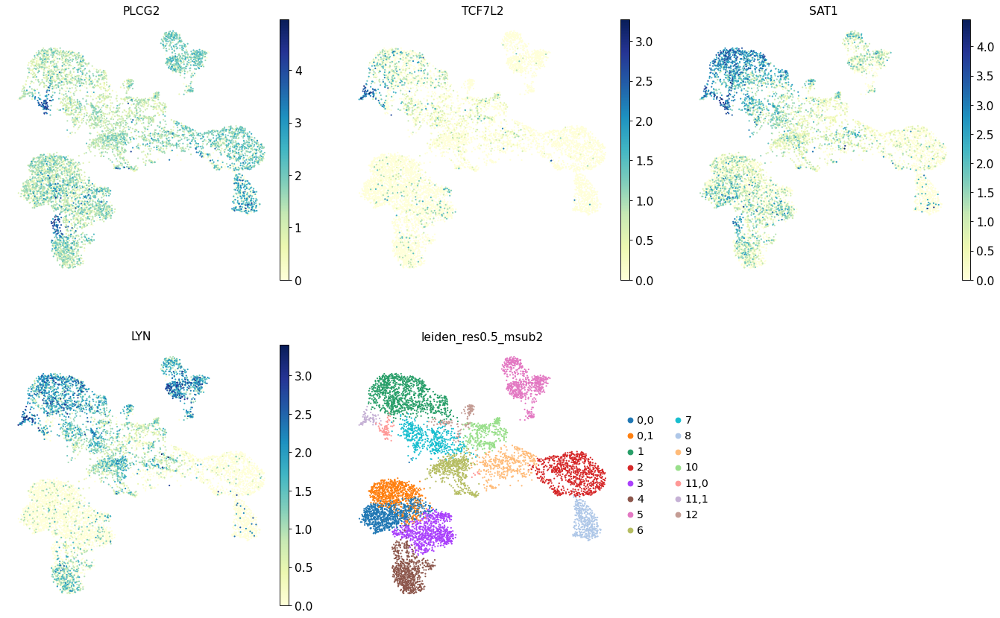

In [68]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [69]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

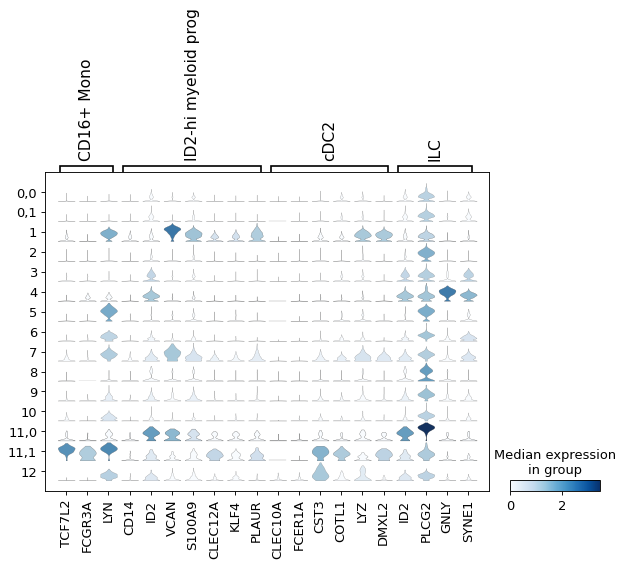

In [70]:
# cluster 11: CD16 + Monocytes, or CD14+Monocytes, cDC2, or ILC
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'ILC']}, groupby=new_key)

This clearly identifies:
- 11,0: CD14 + Monocyte progenitors
- 11,1: CD16+ Monocytes and cDC2


### Cluster 12

In [71]:
orig_key = 'leiden_res0.5_msub2'
new_key = 'leiden_res0.5_msub3'
new_rg_key = 'rg_res0.5_msub3'
sub_key = '12'

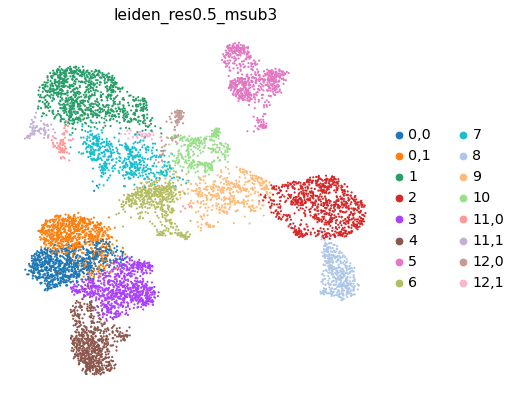

1       991
2       830
0,0     826
3       818
0,1     763
4       693
5       640
6       483
7       481
8       401
9       399
10      327
12,0     88
11,0     76
11,1     73
12,1     42
Name: leiden_res0.5_msub3, dtype: int64

In [72]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.07)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

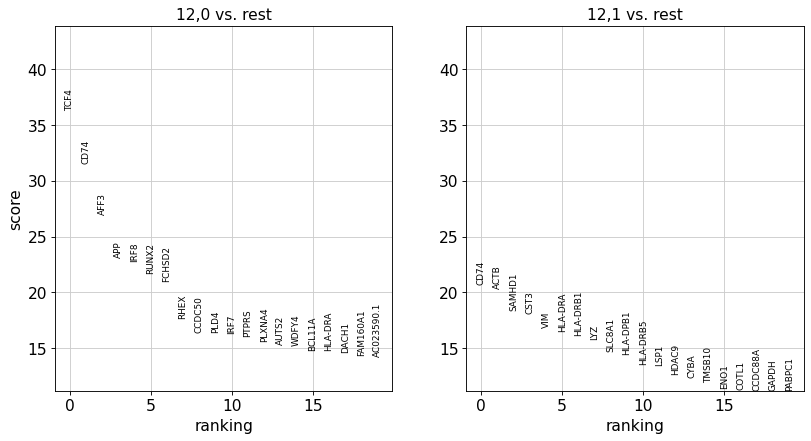

In [73]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

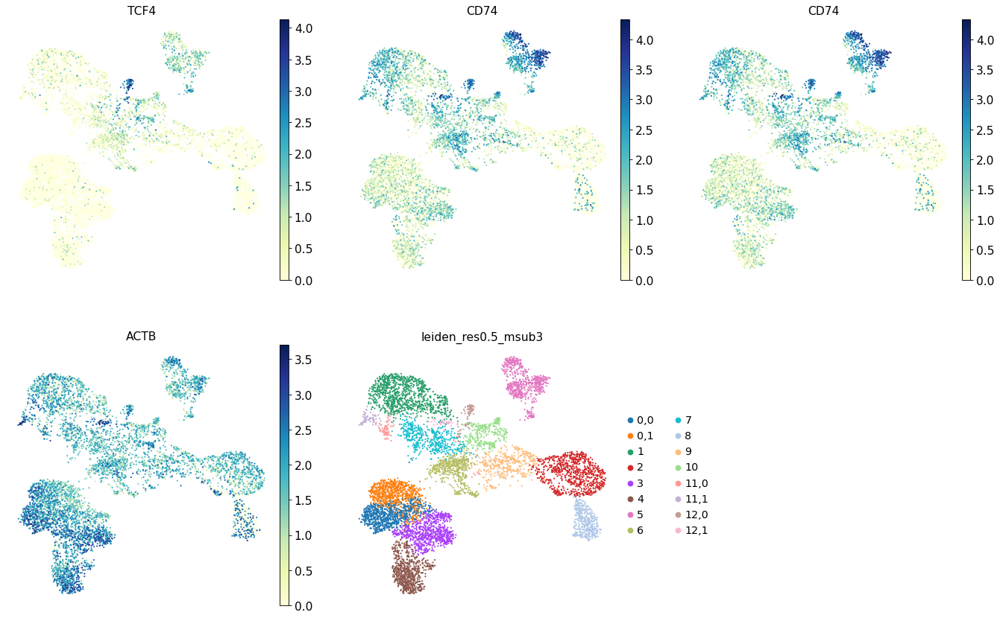

In [74]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [75]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

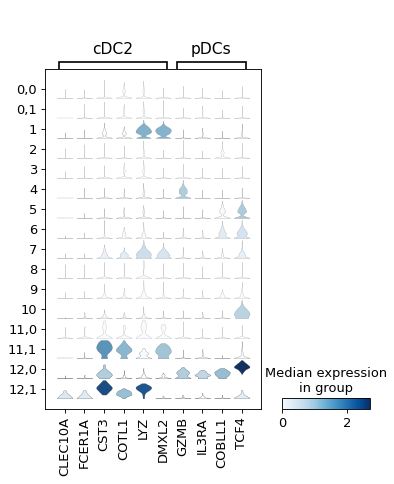

In [76]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['cDC2', 'pDCs']}, groupby=new_key)

This clearly identifies:
- 12.0: pDCs
- 12.1: cDC2


### Summary

- 1: No early monocyte subsets

- 11: separation into two clusters:
    - 11,0: CD14 + Monocyte progenitors
    - 11,1: CD16+ Monocytes and cDC2
    


- 12: separation into two clusters:
    - 12.0: pDCs
    - 12.1: cDC2



## B cells - cluster 5

In [77]:
orig_key = 'leiden_res0.5_msub3'
new_key = 'leiden_res0.5_bsub'
new_rg_key = 'rg_res0.5_bsub'
sub_key = '5'

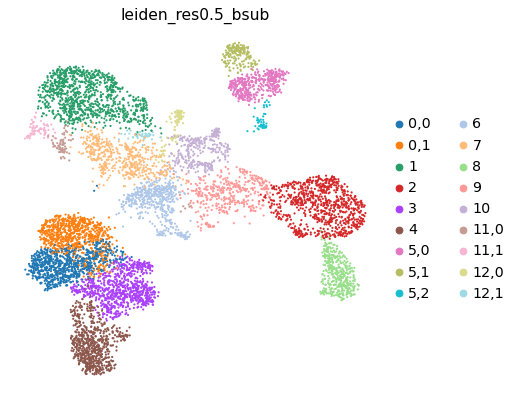

1       991
2       830
0,0     826
3       818
0,1     763
4       693
6       483
7       481
5,0     415
8       401
9       399
10      327
5,1     174
12,0     88
11,0     76
11,1     73
5,2      51
12,1     42
Name: leiden_res0.5_bsub, dtype: int64

In [78]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

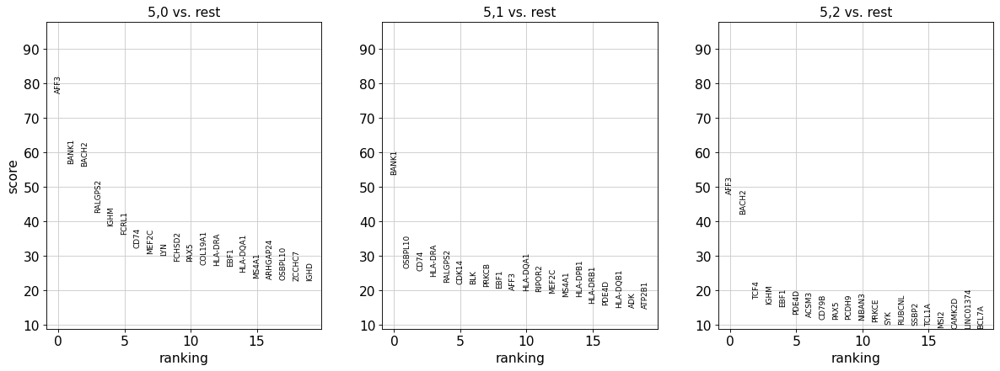

In [79]:
num_subclusts = 3
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

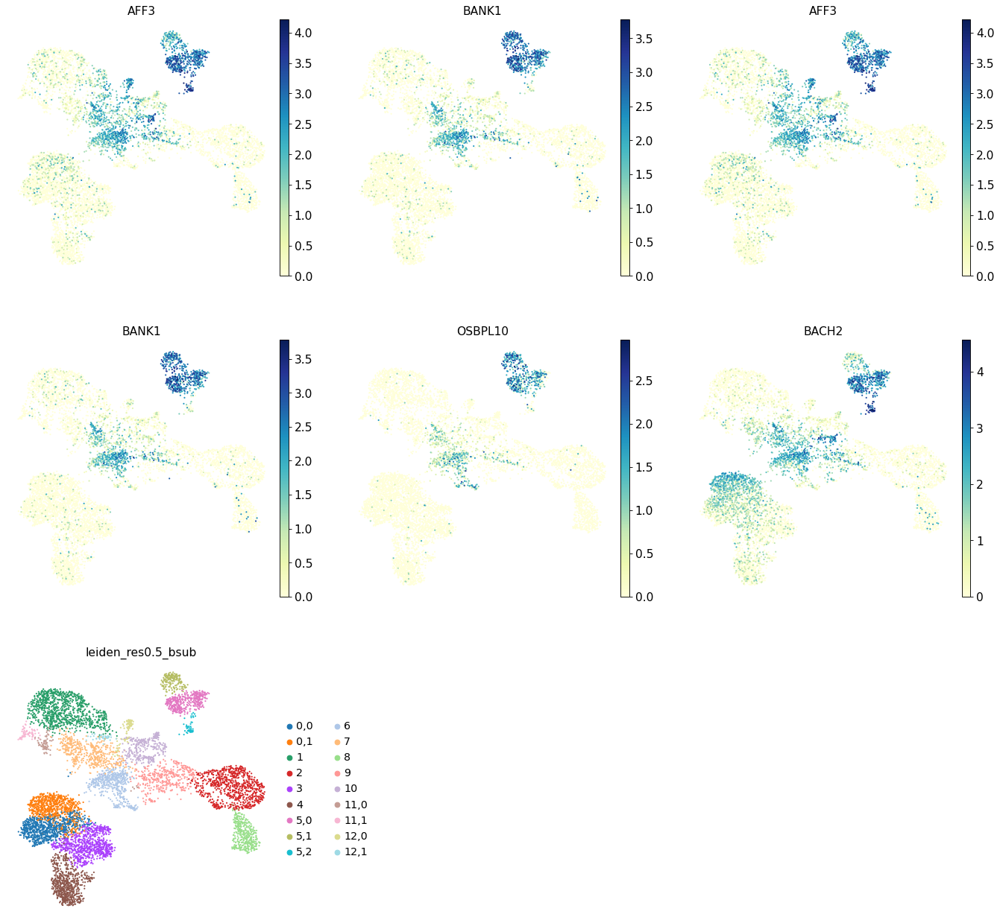

In [80]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [81]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

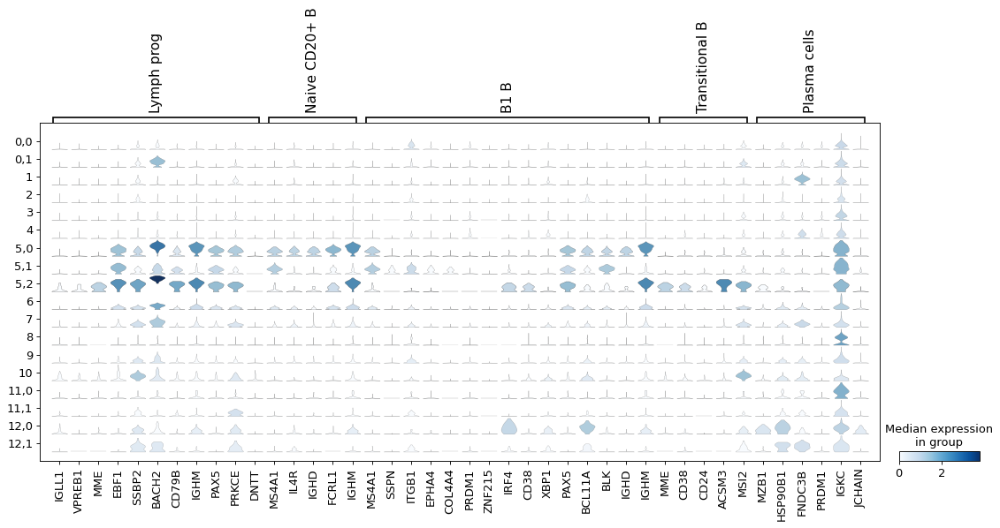

In [82]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog', 'Naive CD20+ B', 'B1 B', 
                                                                       'Transitional B', 'Plasma cells']}, groupby=new_key)

### Summary

3 subclusters:
- 5,0: Naive CD20+ B
- 5,1: B1 B
- 5,2: Transitional B

## Erythrocyte precursors - cluster 2

In [83]:
orig_key = 'leiden_res0.5_bsub'
new_key = 'leiden_res0.5_epsub'
new_rg_key = 'rg_res0.5_epsub'
sub_key = '2'

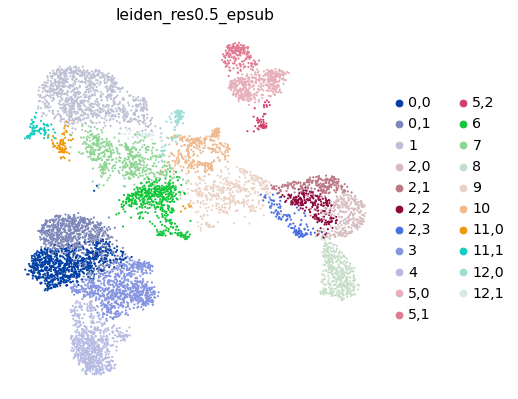

1       991
0,0     826
3       818
0,1     763
4       693
6       483
7       481
5,0     415
8       401
9       399
10      327
2,0     284
2,1     218
2,2     211
5,1     174
2,3     117
12,0     88
11,0     76
11,1     73
5,2      51
12,1     42
Name: leiden_res0.5_epsub, dtype: int64

In [84]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.3)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

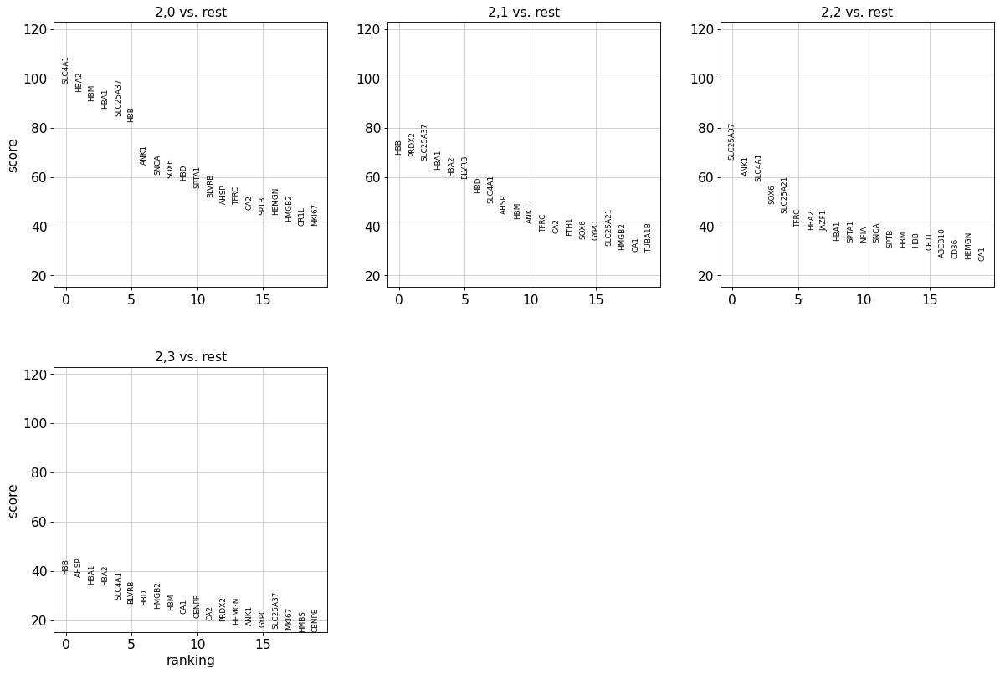

In [85]:
num_subclusts = 4
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

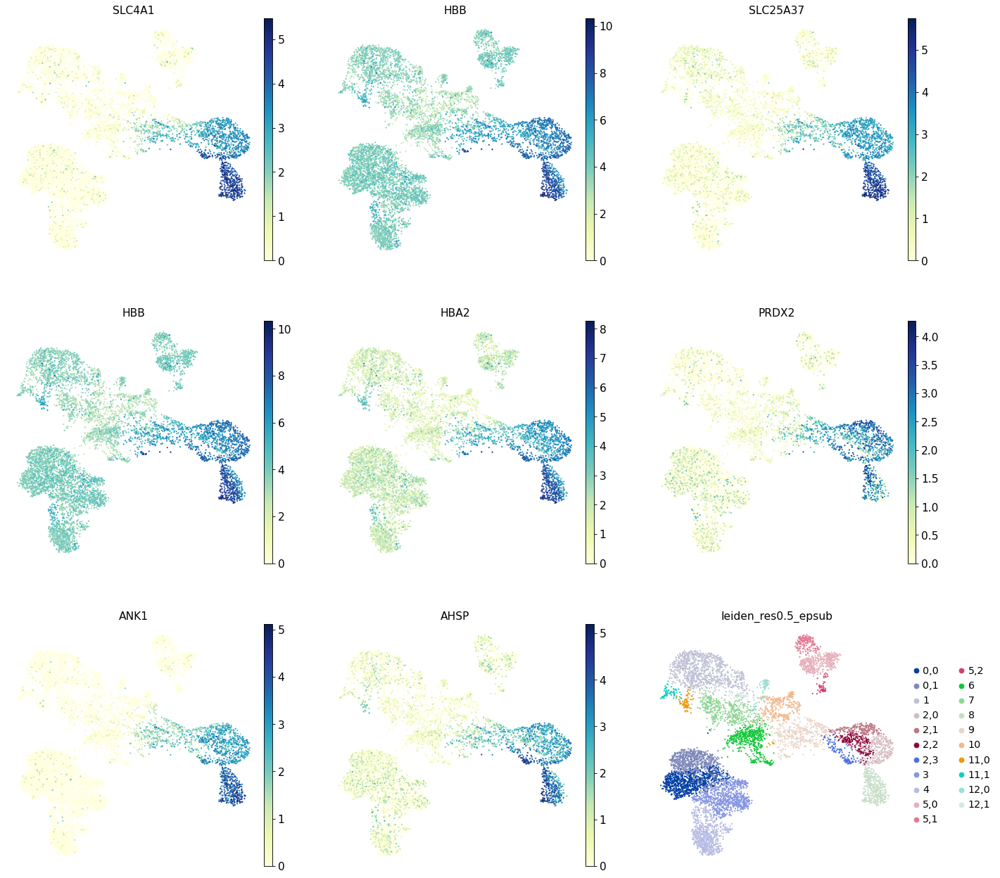

In [86]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

Now, let's check the cell-cycle for each sub-cluster.

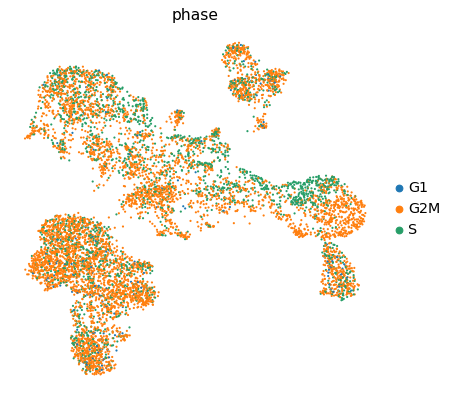

In [87]:
sc.pl.umap(adata_gex, color=['phase'])

It seems that the 2,1 subcluster contains cells with mostly at S phase.

In [88]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

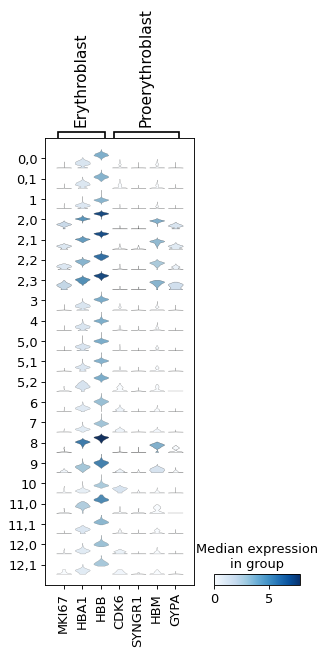

In [89]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

### Summary

- 2,0: Erythroblasts
- 2,1: Erythroblasts (different CC stage, S phase)
- 2,2: Erythroblasts
- 2.3: Erythroblasts


-> We don't need to subcluster this cluster 2, as it's mostly erythroblast cells.

Note. "CRACD" gene was not found in the data for some reason, thus I excluded it from the marker gene list. I'm not sure what to do...does that mean we need to revisit the marker gene list across datasets based on the common genes that were shared across all datasets?

## Hematopoietic progenitors - cluster 10

In [90]:
# Use the key from the B cell cluster 5, not the previous one, as we don't sub-cluster the cluster 2 anymore.
orig_key = 'leiden_res0.5_bsub'
new_key = 'leiden_res0.5_progsub'
new_rg_key = 'rg_res0.5_progsub'
sub_key = '10'

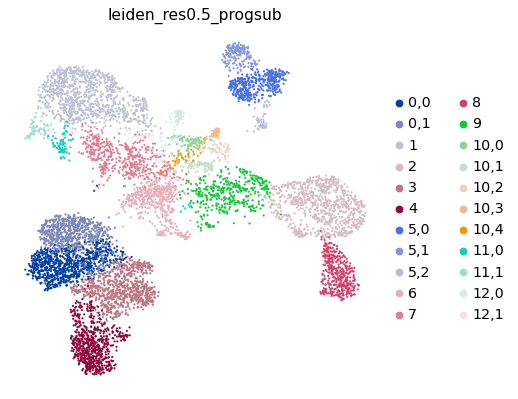

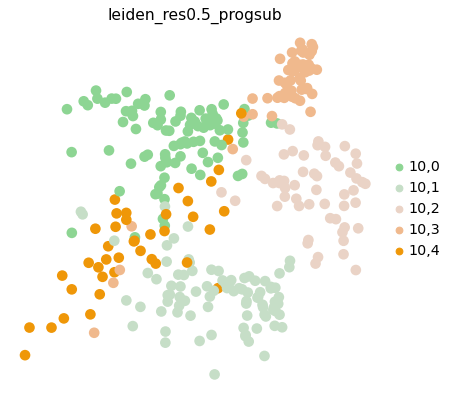

1       991
2       830
0,0     826
3       818
0,1     763
4       693
6       483
7       481
5,0     415
8       401
9       399
5,1     174
10,0     91
12,0     88
10,1     87
11,0     76
11,1     73
10,2     55
10,3     54
5,2      51
12,1     42
10,4     40
Name: leiden_res0.5_progsub, dtype: int64

In [91]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.4)
sc.pl.umap(adata_gex, color=new_key)

#This is a small cluster, so let's zoom in!
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

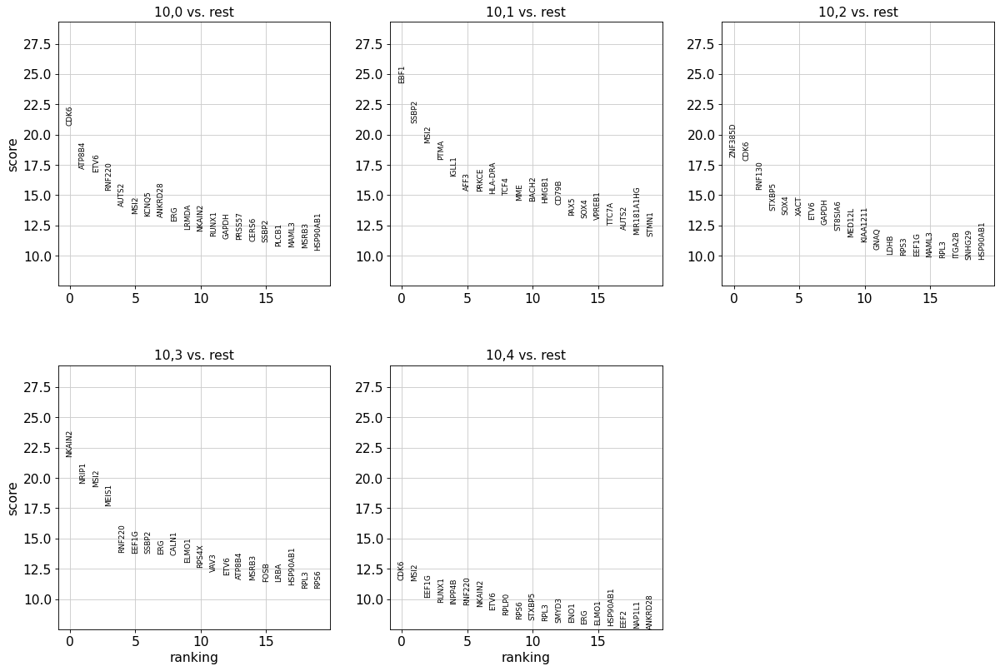

In [92]:
num_subclusts = 5
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

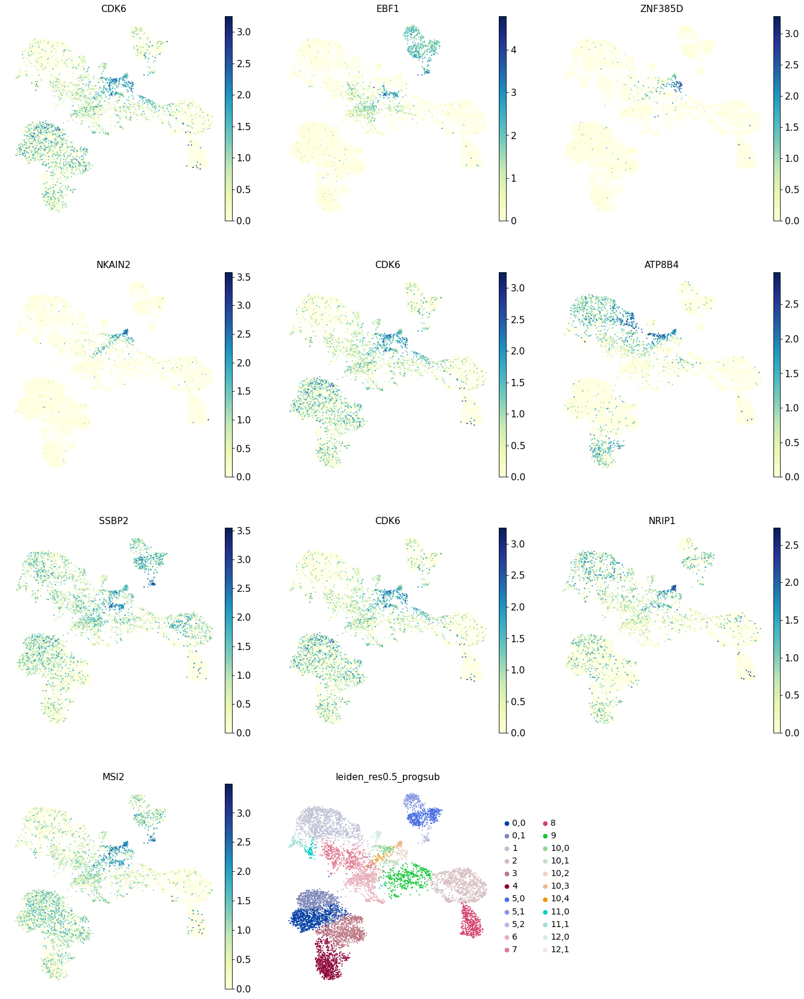

In [93]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [94]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

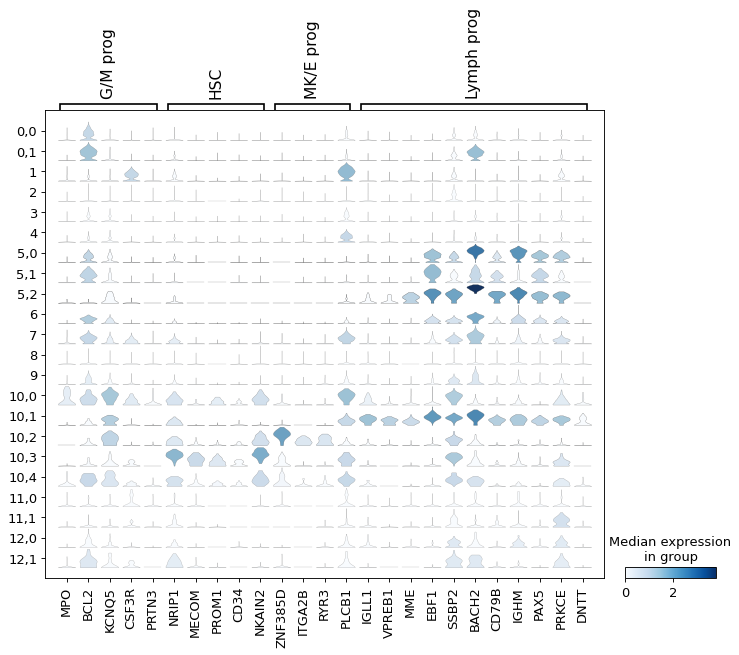

In [95]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['G/M prog', 'HSC', 'MK/E prog', 'Lymph prog']}, groupby=new_key)

### Summary

- 10,0: G/M prog
- 10,1: Lymph prog
- 10,2: MK/E prog
- 10,3: HSC
- 10,4: G/M prog

## NK and ILCs

### Cluster 4

In [96]:
orig_key = 'leiden_res0.5_progsub'
new_key = 'leiden_res0.5_4sub'
new_rg_key = 'rg_res0.5_4sub'
sub_key = '4'

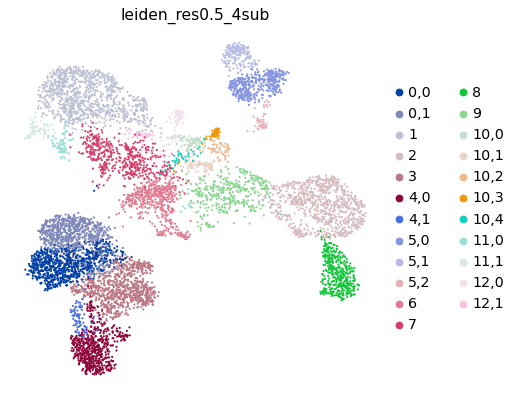

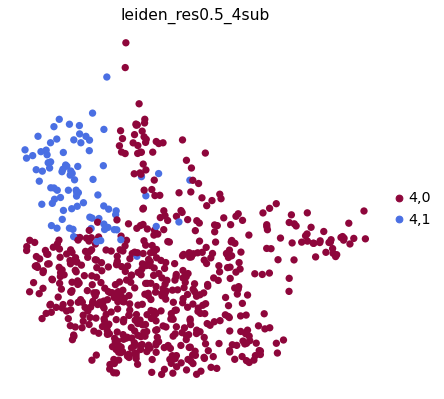

1       991
2       830
0,0     826
3       818
0,1     763
4,0     607
6       483
7       481
5,0     415
8       401
9       399
5,1     174
10,0     91
12,0     88
10,1     87
4,1      86
11,0     76
11,1     73
10,2     55
10,3     54
5,2      51
12,1     42
10,4     40
Name: leiden_res0.5_4sub, dtype: int64

In [97]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.17)
sc.pl.umap(adata_gex, color=new_key)
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

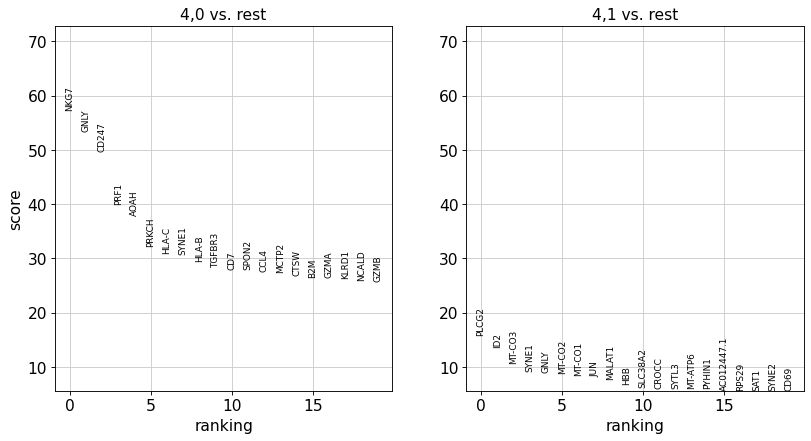

In [98]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

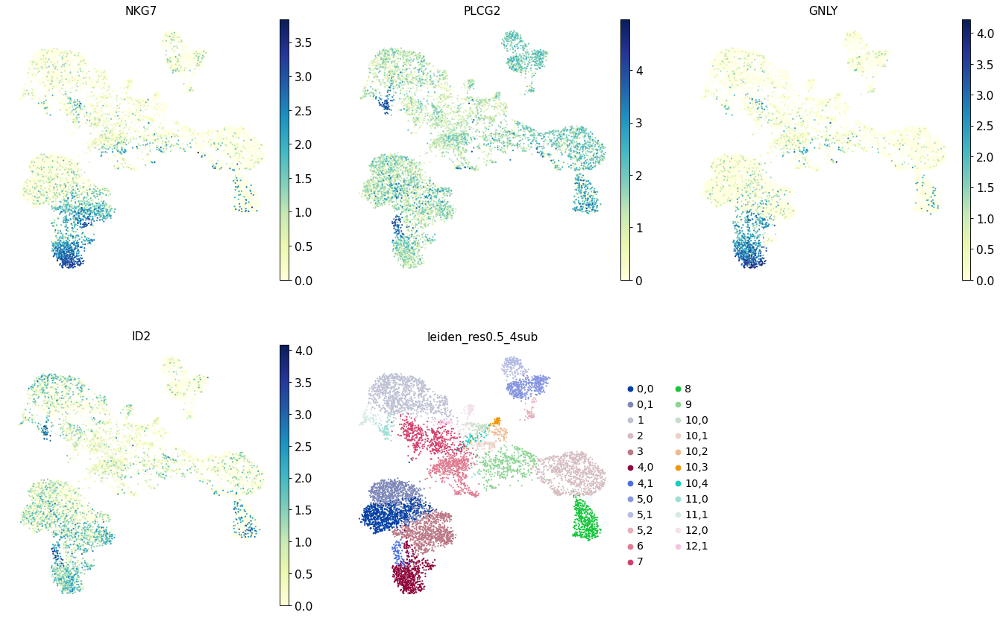

In [99]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [100]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

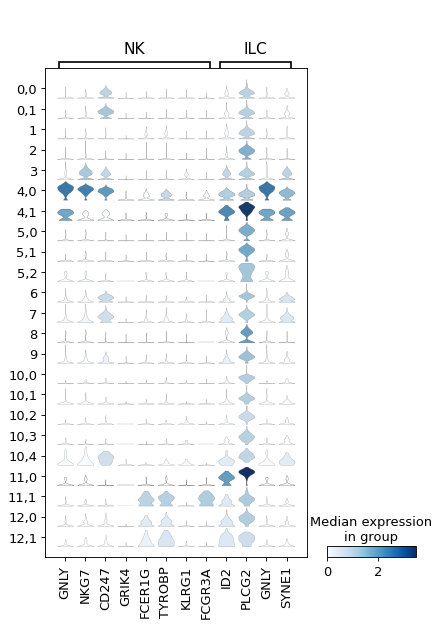

In [101]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['NK', 'ILC']}, groupby=new_key)

### Summary

- 4,0: NK cells
- 4,1: ILC

## The mess - clusters 6 and 7

### Cluster 6

In [102]:
orig_key = 'leiden_res0.5_4sub'
new_key = 'leiden_res0.5_6sub'
new_rg_key = 'rg_res0.5_6sub'
sub_key = '6'

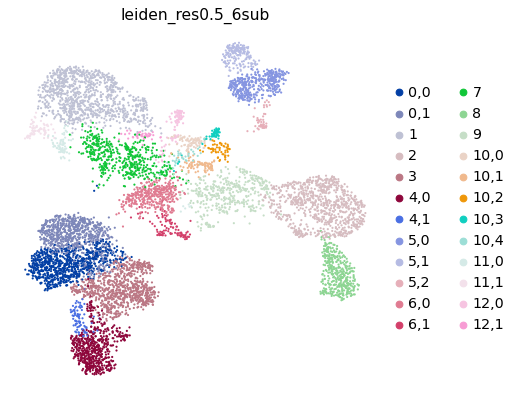

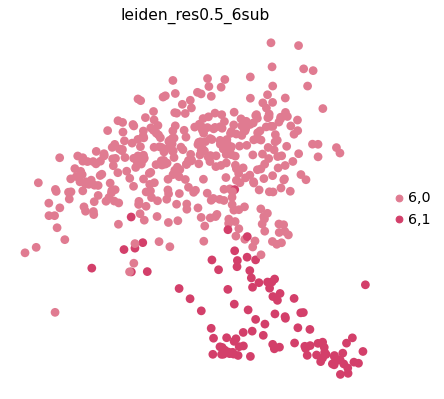

1       991
2       830
0,0     826
3       818
0,1     763
4,0     607
7       481
5,0     415
8       401
9       399
6,0     384
5,1     174
6,1      99
10,0     91
12,0     88
10,1     87
4,1      86
11,0     76
11,1     73
10,2     55
10,3     54
5,2      51
12,1     42
10,4     40
Name: leiden_res0.5_6sub, dtype: int64

In [103]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

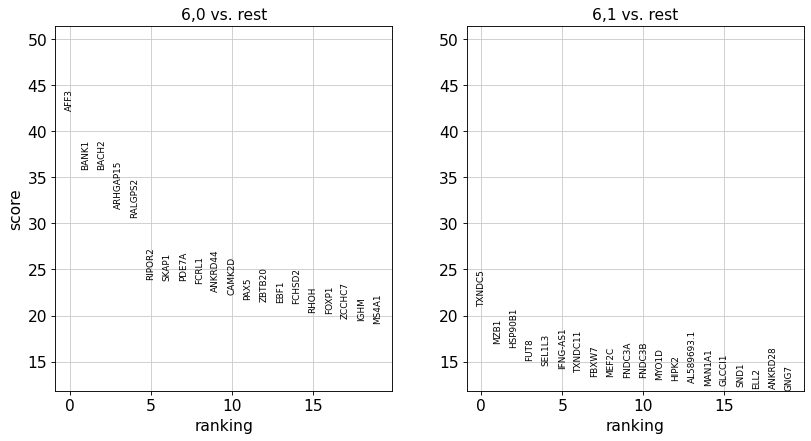

In [104]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

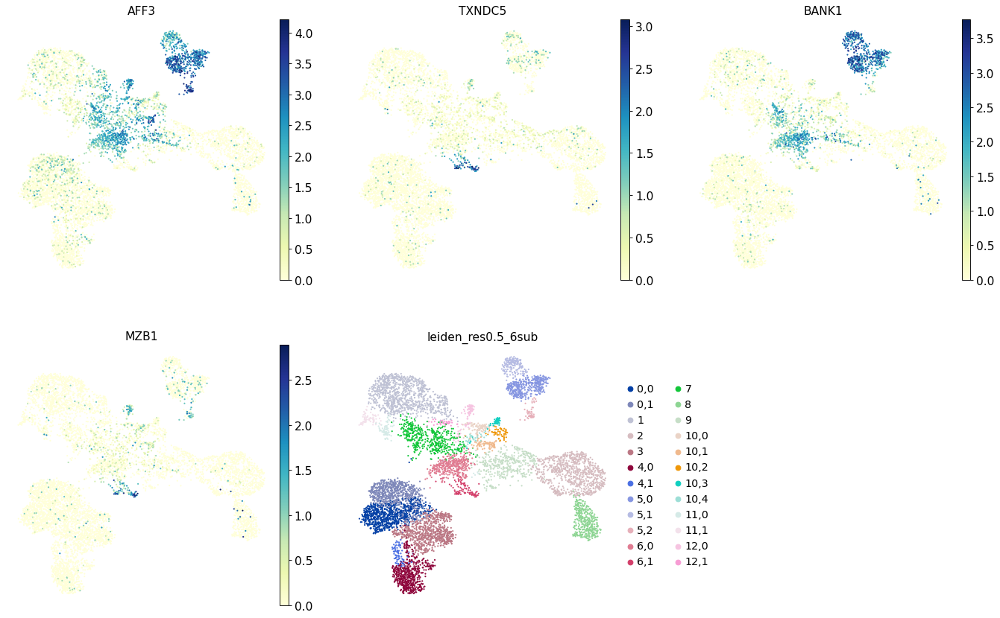

In [105]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

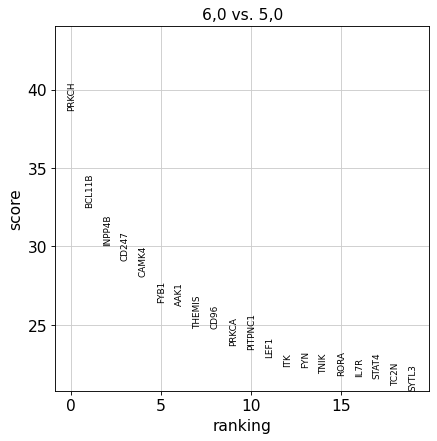

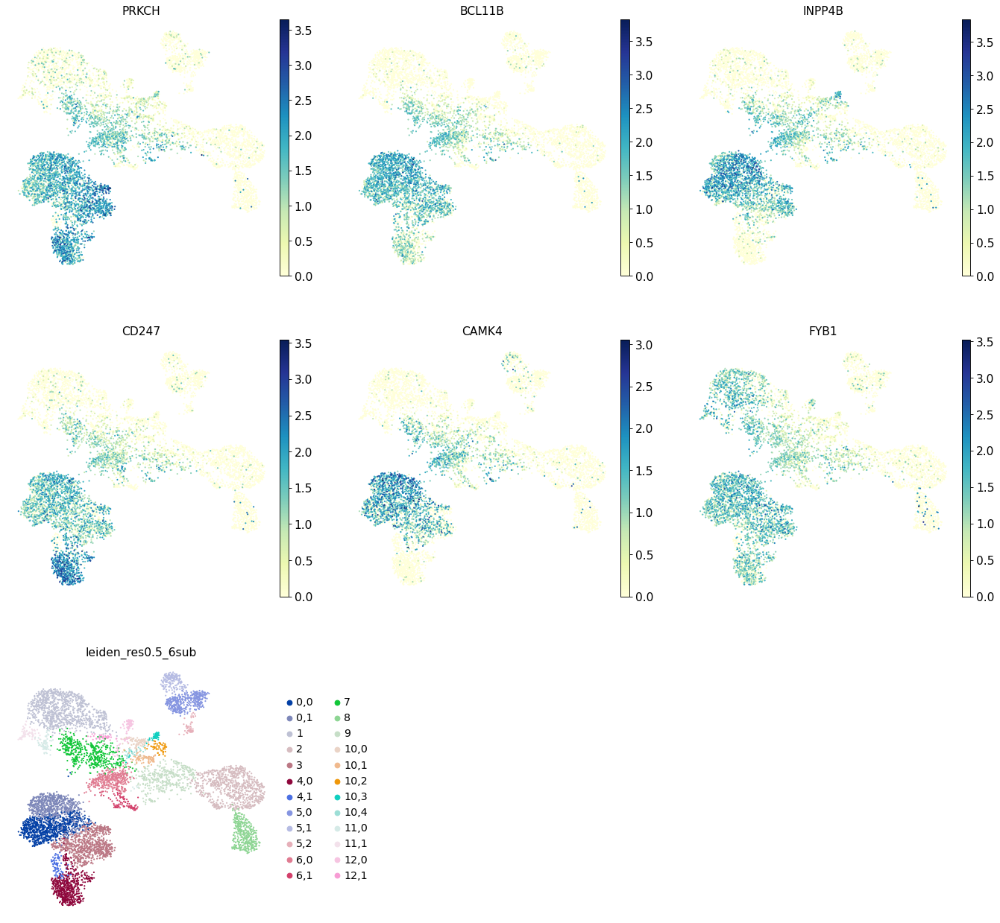

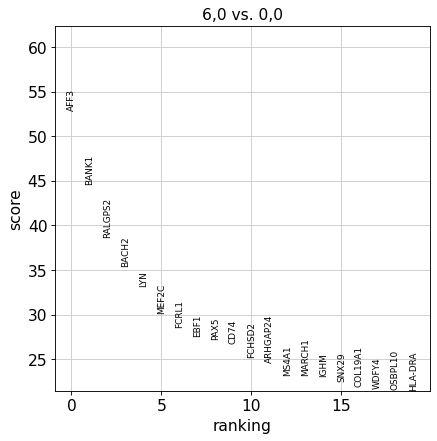

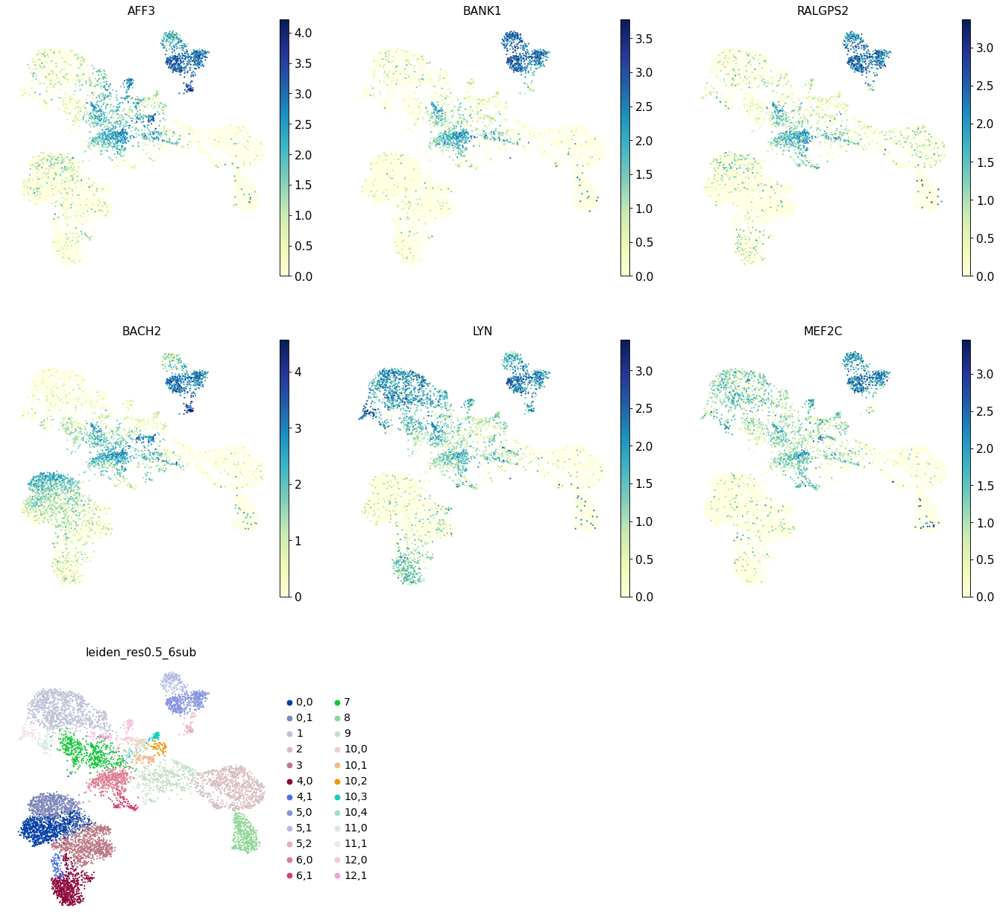

In [106]:
# Compare 6,0 to B cells and T cells - this cluster seems to have markers of both!
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['6,0'], reference='5,0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['6,0'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['6,0'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['6,0'], reference='0,0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['6,0'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['6,0'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

... storing 'test' as categorical


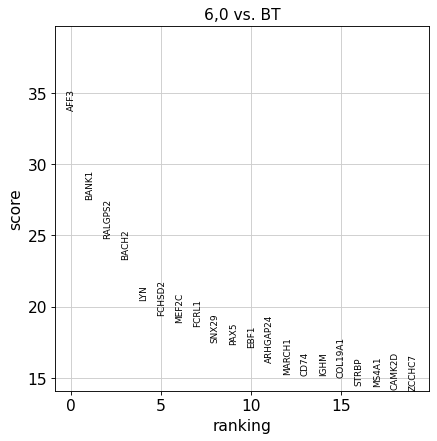

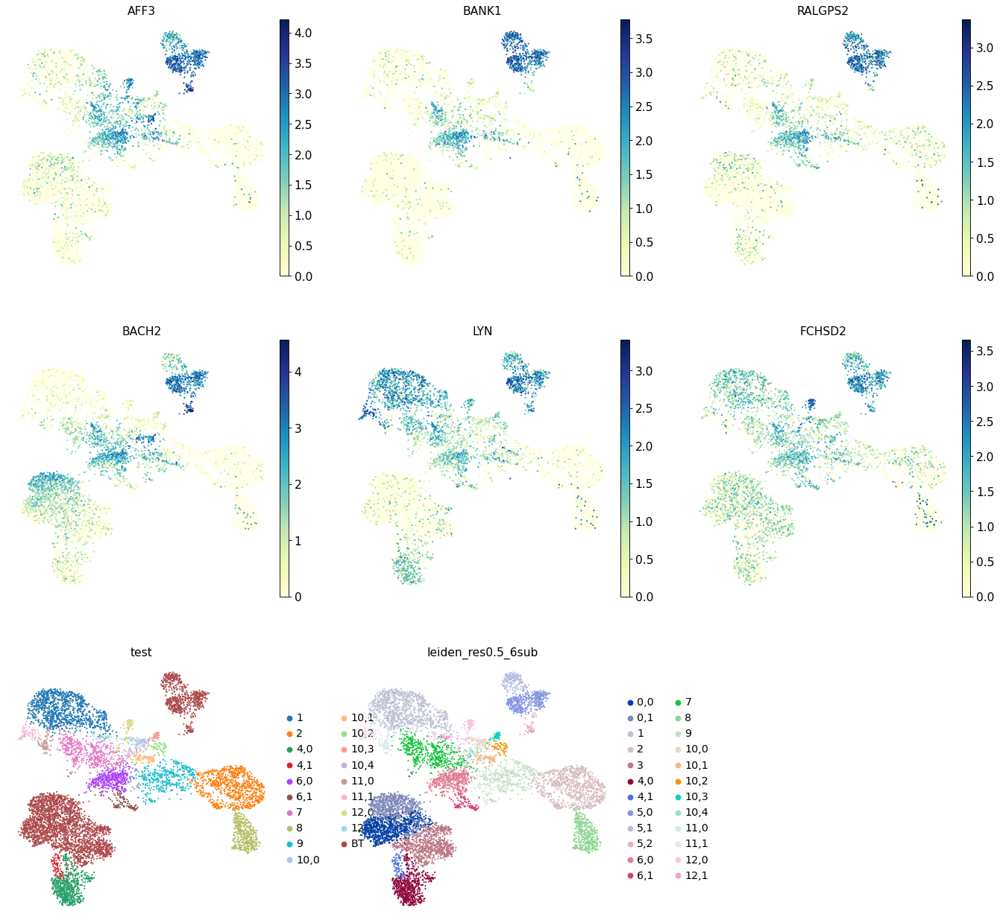

In [107]:
# Compare 6,0 to B and T cells at the same time
adata_gex.obs['test'] = ['BT' if ct in ['5,0', '5,1', '5,2', '0,0', '0,1', '3'] else ct for ct in adata_gex.obs[new_key]]

sc.tl.rank_genes_groups(adata_gex, groupby='test', key_added='test_comp', groups=['6,0'], reference='BT')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['6,0'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['6,0'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+['test', new_key], ncols=3)

Cluster 6,0 shares all markers with other cell types (B and T cells) and expresses these weaker than those cell types

In [108]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

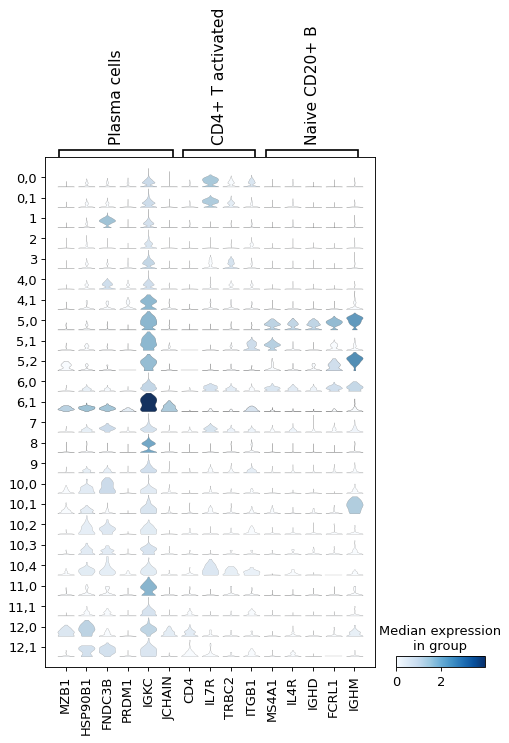

In [109]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Plasma cells', 'CD4+ T activated', 'Naive CD20+ B']}, groupby=new_key)

There are 2 clusters:
- 6,0: Doublets (no unique markers between B and T cells)
- 6,1: Plasma cells

### Cluster 7

In [110]:
orig_key = 'leiden_res0.5_6sub'
new_key = 'leiden_res0.5_7sub'
new_rg_key = 'rg_res0.5_7sub'
sub_key = '7'

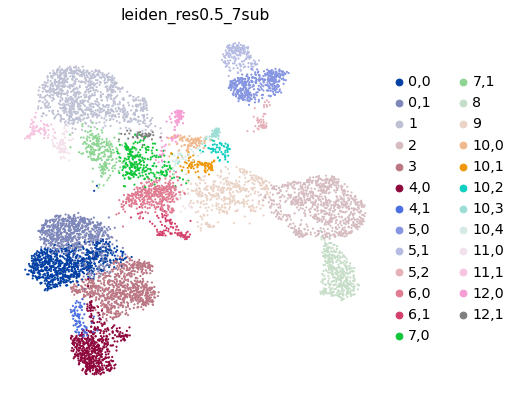

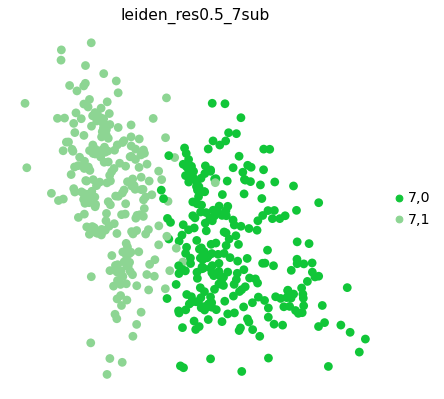

1       991
2       830
0,0     826
3       818
0,1     763
4,0     607
5,0     415
8       401
9       399
6,0     384
7,0     257
7,1     224
5,1     174
6,1      99
10,0     91
12,0     88
10,1     87
4,1      86
11,0     76
11,1     73
10,2     55
10,3     54
5,2      51
12,1     42
10,4     40
Name: leiden_res0.5_7sub, dtype: int64

In [111]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.2)
sc.pl.umap(adata_gex, color=new_key)
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

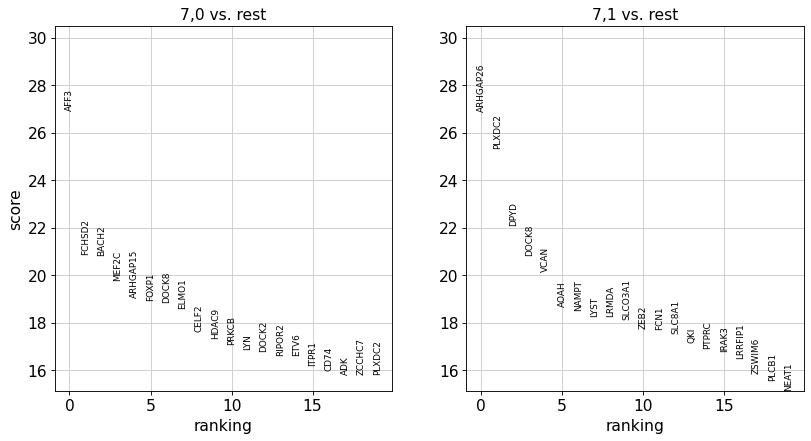

In [112]:
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

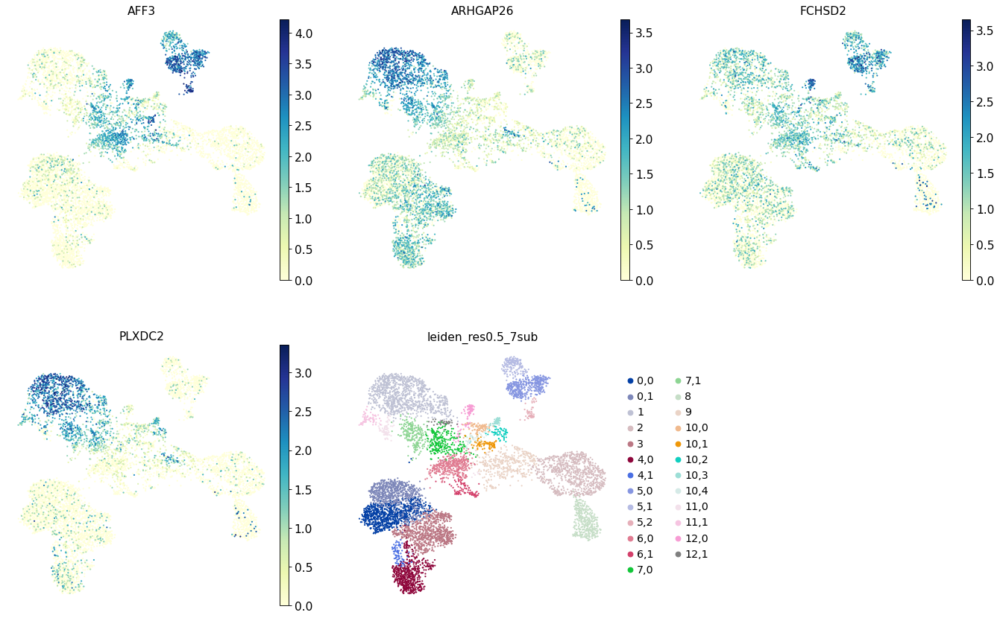

In [113]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

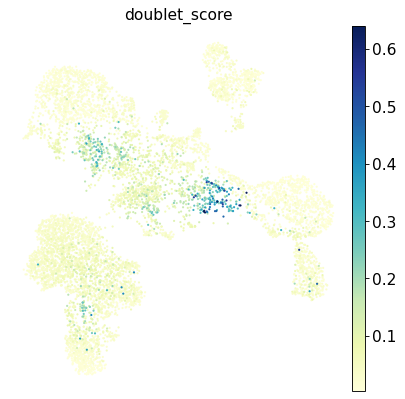

In [114]:
sc.pl.umap(adata_gex, color='doublet_score')

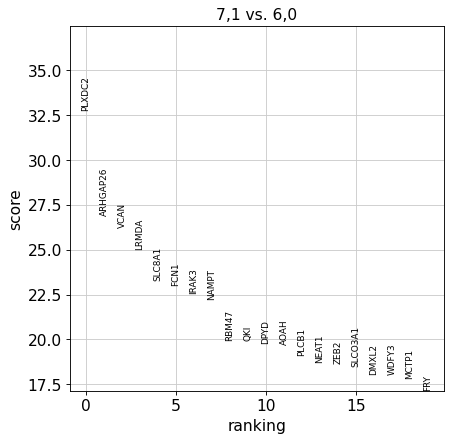

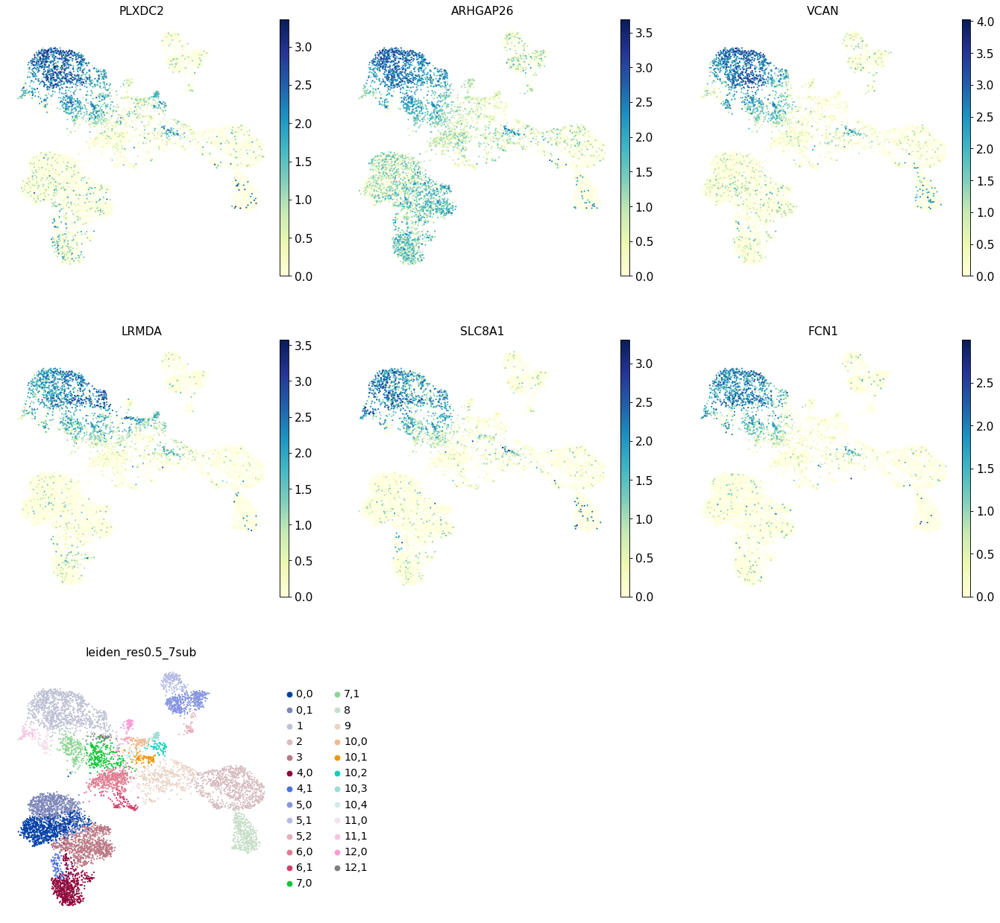

In [115]:
# Compare 7,1 to 6,0 above
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['7,1'], reference='6,0')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['7,1'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['7,1'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

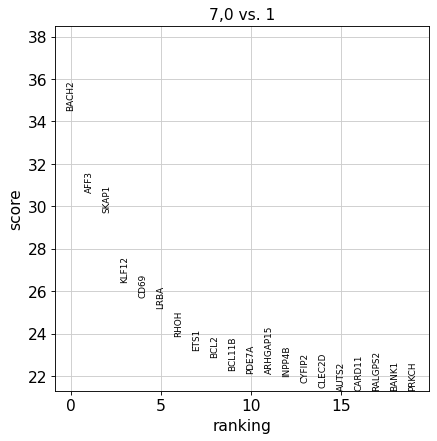

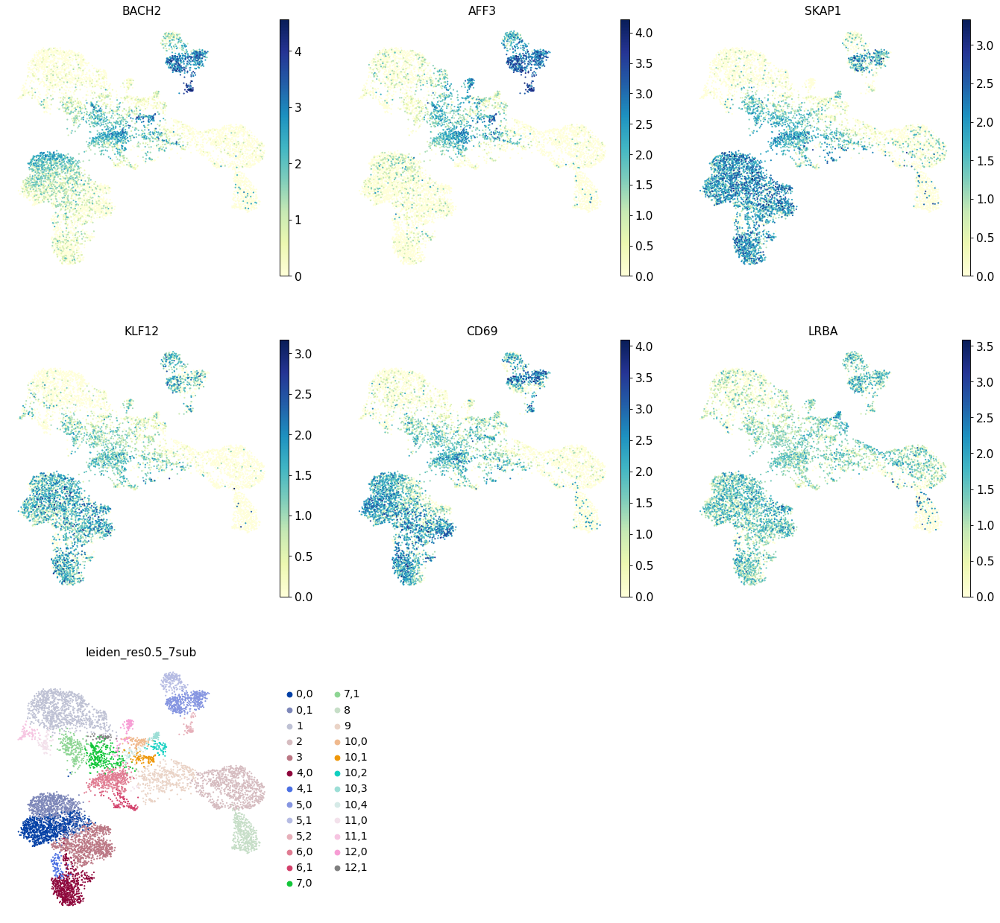

In [116]:
# Compare 7,0 to 1 below
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added='test_comp', groups=['7,0'], reference='1')
sc.pl.rank_genes_groups(adata_gex, key='test_comp', groups=['7,0'], ncols=3)
top_6_genes = list(adata_gex.uns['test_comp']['names']['7,0'][:6])
sc.pl.umap(adata_gex, color=top_6_genes+[new_key], ncols=3)

In [117]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

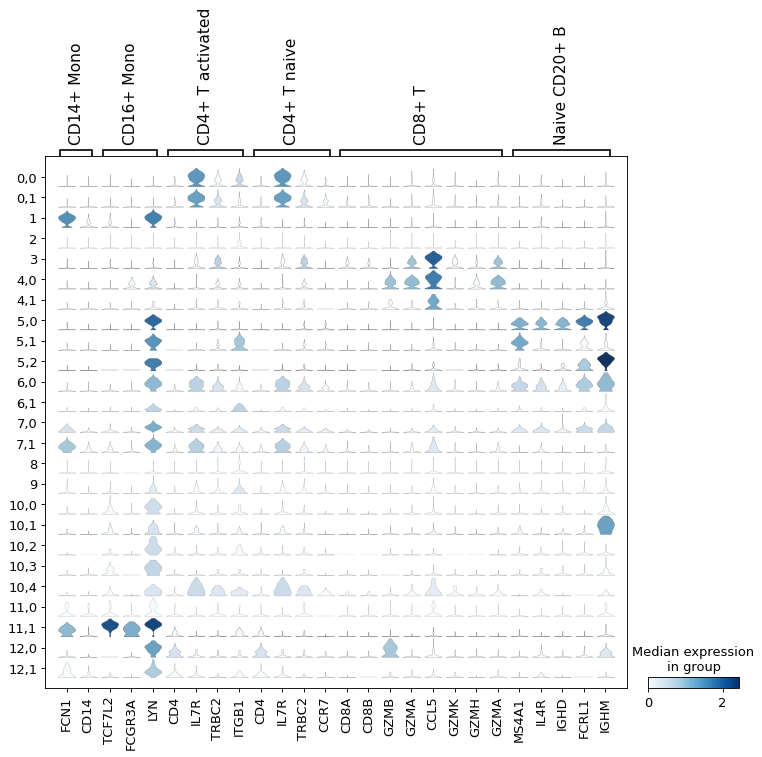

In [118]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'CD16+ Mono','CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'Naive CD20+ B']}, groupby=new_key)

### Summary

Cluster 7: 2 clusters that are likely both doublets
- 7,0: Monocytes & B cells
- 7,1: Monocytes & T cells

## The doublet cluster - Cluster 9

### Cluster 9

In [119]:
orig_key = 'leiden_res0.5_7sub'
new_key = 'leiden_res0.5_doubsub'
new_rg_key = 'rg_res0.5_doubsub'
sub_key = '9'

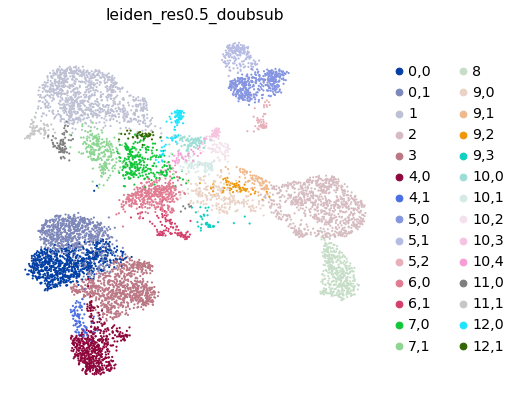

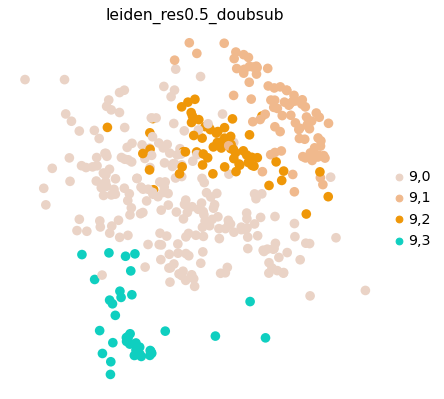

1       991
2       830
0,0     826
3       818
0,1     763
4,0     607
5,0     415
8       401
6,0     384
7,0     257
7,1     224
9,0     219
5,1     174
6,1      99
10,0     91
12,0     88
10,1     87
4,1      86
9,1      79
11,0     76
11,1     73
9,2      63
10,2     55
10,3     54
5,2      51
12,1     42
10,4     40
9,3      38
Name: leiden_res0.5_doubsub, dtype: int64

In [120]:
sc.tl.leiden(adata_gex, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=0.3)
sc.pl.umap(adata_gex, color=new_key)
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=new_key)
adata_gex.obs[new_key].value_counts()

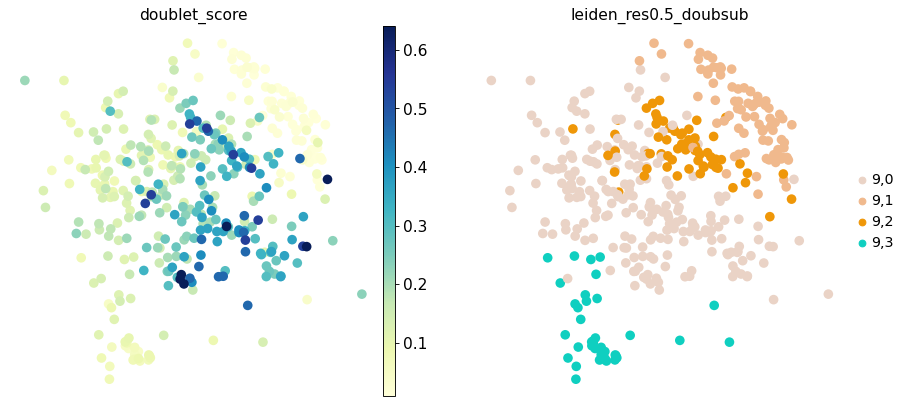

In [121]:
sc.pl.umap(adata_gex[adata_gex.obs[orig_key].isin([sub_key])], color=['doublet_score', new_key])


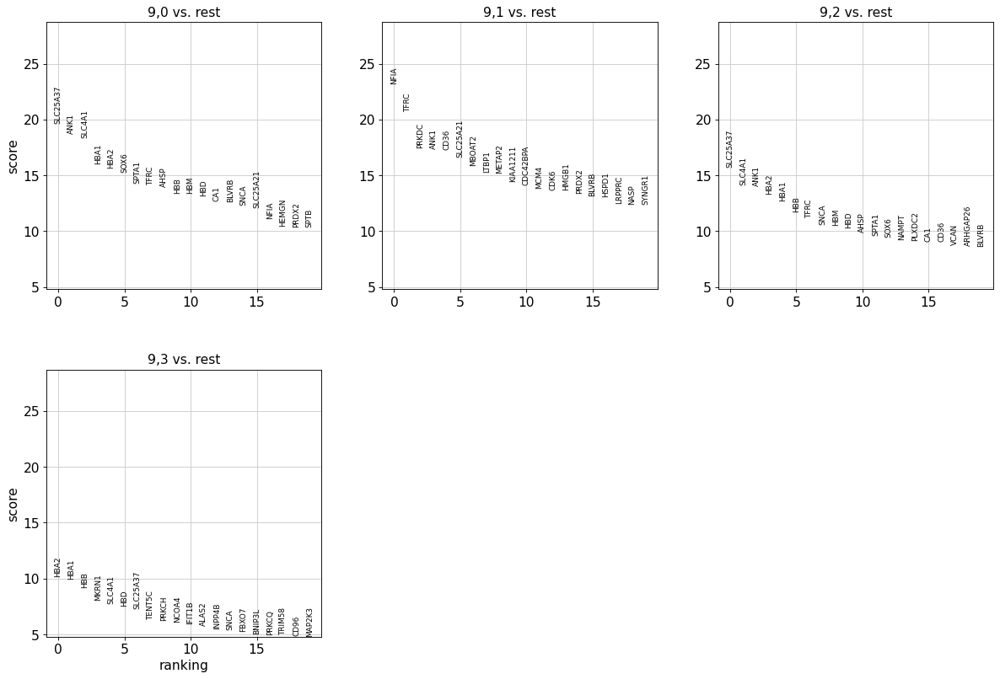

In [122]:
num_subclusts = 4
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

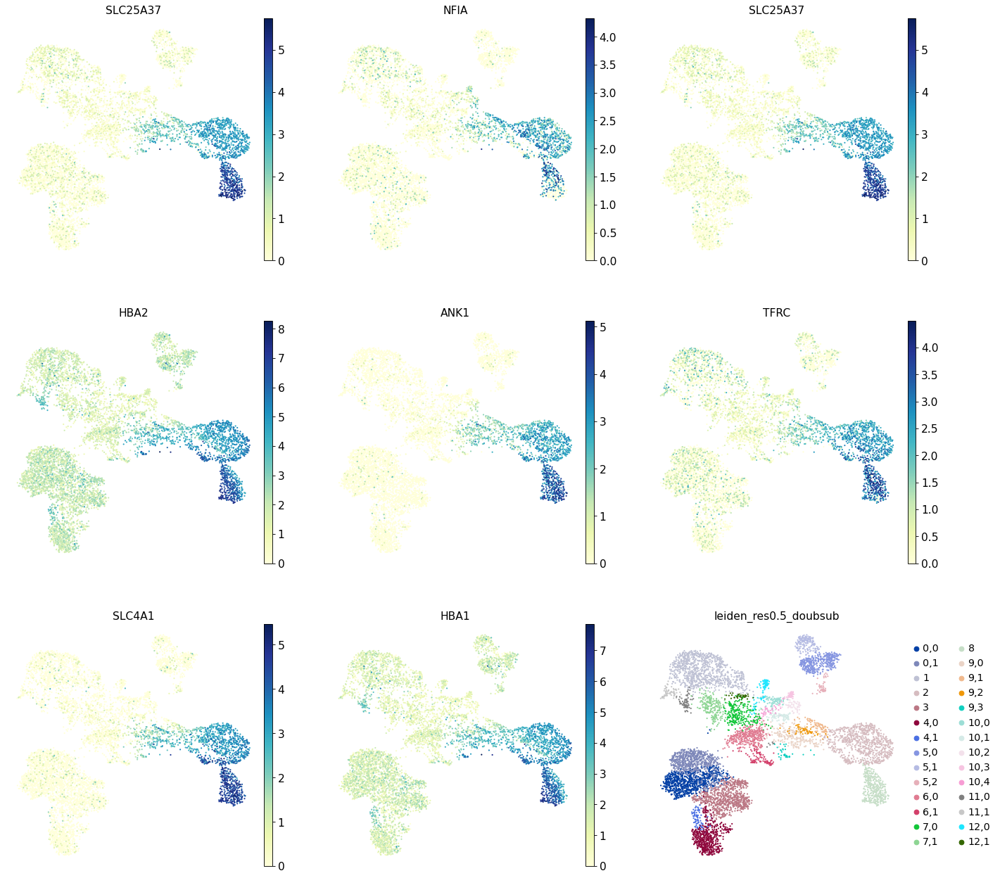

In [123]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

In [124]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

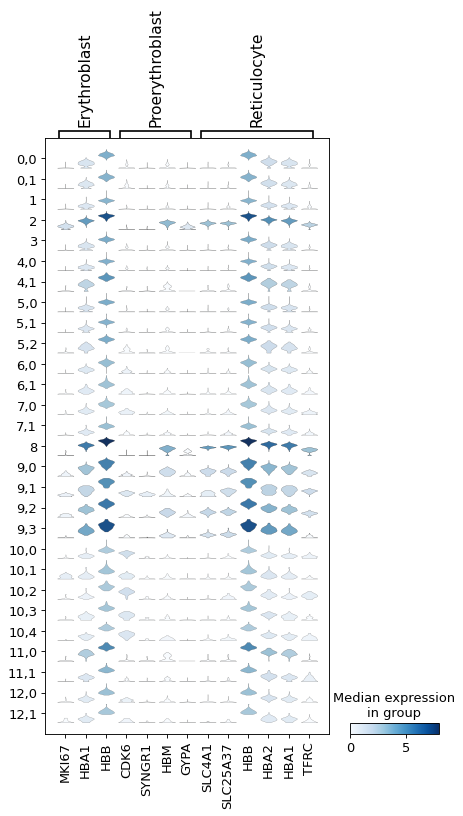

In [125]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Erythroblast', 'Proerythroblast','Reticulocyte']}, groupby=new_key)
# Note HBM and GYPA are negative markers for proerythroblasts!

### Summary

- 9,0: Looks like doublets of erythroblasts and other cells
- 9,1: Proerythroblasts (SYNGR1) and reticulocytes
- 9,2: Looks like doublets of reticulocytes and other cells
- 9,3: Looks like doublets of erythroblasts and reticulocytes (further dissected below for the gene expression profiles)

=> Filter out both 9,0, 9,2, and 9,3 as they seem to be doublets.

# Cluster overview

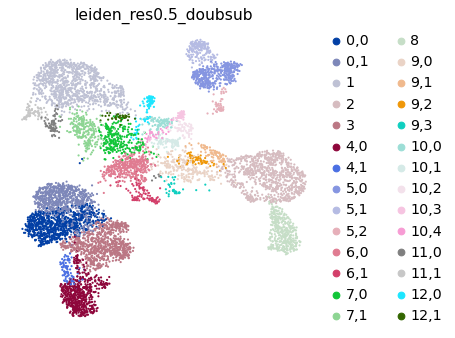

In [126]:
plt.rcParams['figure.figsize'] = (5,5)
sc.pl.umap(adata_gex, color='leiden_res0.5_doubsub')
plt.rcParams['figure.figsize'] = (5,5)

## Doublet filtering

In [127]:
adata_gex.obs['leiden_res0.5_doubsub'].value_counts()

1       991
2       830
0,0     826
3       818
0,1     763
4,0     607
5,0     415
8       401
6,0     384
7,0     257
7,1     224
9,0     219
5,1     174
6,1      99
10,0     91
12,0     88
10,1     87
4,1      86
9,1      79
11,0     76
11,1     73
9,2      63
10,2     55
10,3     54
5,2      51
12,1     42
10,4     40
9,3      38
Name: leiden_res0.5_doubsub, dtype: int64

In [128]:
np.sum(adata_gex.obs['leiden_res0.5_doubsub'].value_counts())

7931

In [129]:
(384 + 219 + 63 + 257 + 224 + 38)/7931

0.1494136931030135

Doublet clusters:
- 9,0, 9,2, and 9,3 (highly likely) = 384 + 219 +38 = 641 cells
- 7,0 and 7,1 (likely) = 257 + 224 = 481
- 6,0 (highly likely) = 63 cells

=> total 1185/7931 cells = 14.9% (seems quite high)


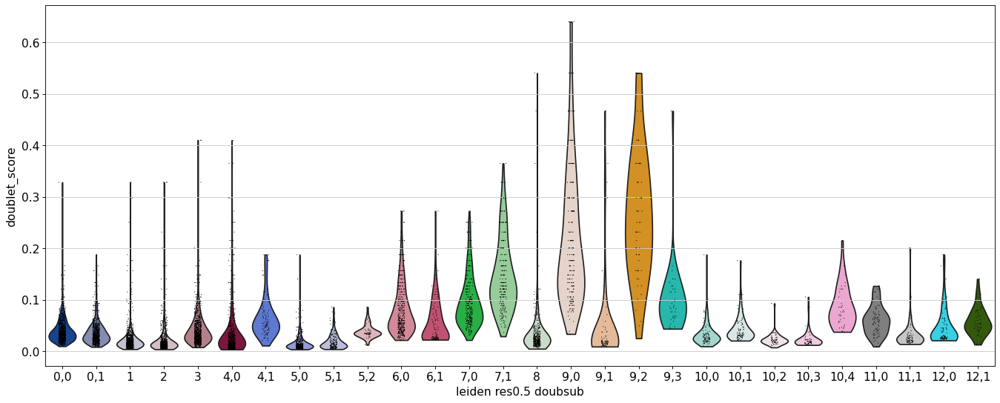

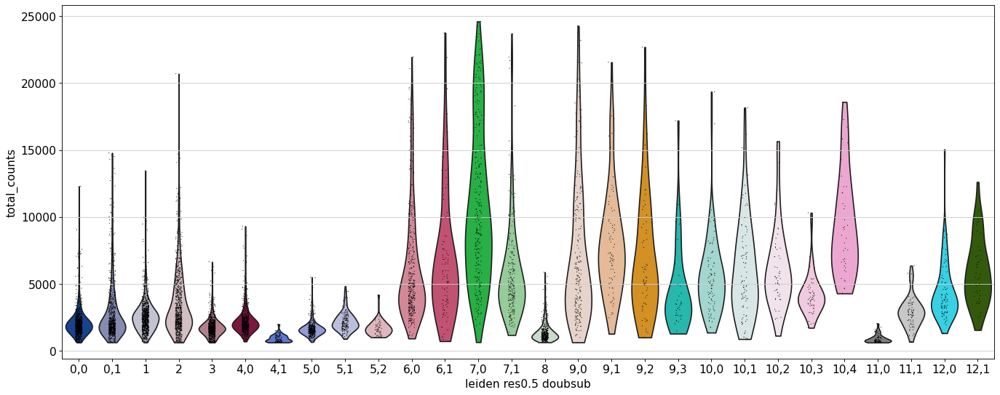

In [130]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_gex, keys='doublet_score', groupby='leiden_res0.5_doubsub')
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.5_doubsub')
plt.rcParams['figure.figsize']=(8,8)


Doublet clusters: Always lower expression than in their "parent" clusters; all RNA markers!
- B & T: 'CD24', 'CD22', 'ARHGAP24', 'BANK1', 'BACH2', 'AFF3', 'CD247', 'BCL11B', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R'
- Erythro+others: 'HBB', 'HBA1', 'ANK1'
- Mono+B: 'PLXDC2', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5'
- Mono+T: 'PLXDC2', 'ARHGAP26', 'FCN1', 'BCL11B', 'SKAP1', 'CD247'

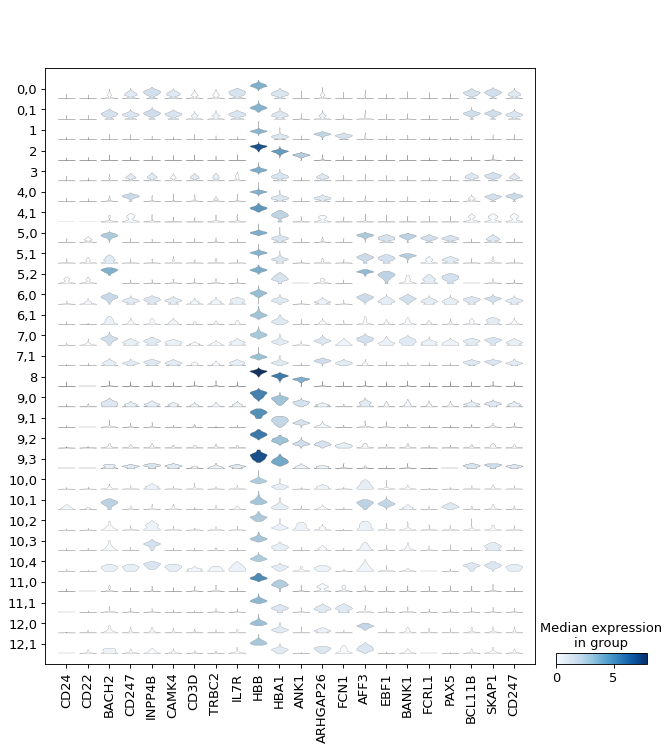

In [131]:
# Check the above markers again to make sure
sc.pl.stacked_violin(adata_gex, var_names=['CD24', 'CD22', 'BACH2', 'CD247', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R', 
                                           'HBB', 'HBA1', 'ANK1', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5', 
                                           'BCL11B', 'SKAP1', 'CD247'], groupby='leiden_res0.5_doubsub')

Indeed the likely doublet clusters have broad expression of all markers, and don't express any marker more highly than any other cell cluster that is not designated as doublet.

In [132]:
adata_gex_filt = adata_gex[~adata_gex.obs['leiden_res0.5_doubsub'].isin(['9,0', '9,2','9,3', '7,0', '7,1', '6,0'])].copy()

## Rename clusters

In [133]:
# Merge HSB
adata_gex_filt.obs['leiden_final'] = ['10,0' if c in ['10,0', '10,4'] else c for c in adata_gex_filt.obs['leiden_res0.5_doubsub']]

adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].astype('category')
adata_gex_filt.obs['leiden_final'].cat.categories
adata_gex_filt.obs['leiden_final'].value_counts()

1       991
2       830
0,0     826
3       818
0,1     763
4,0     607
5,0     415
8       401
5,1     174
10,0    131
6,1      99
12,0     88
10,1     87
4,1      86
9,1      79
11,0     76
11,1     73
10,2     55
10,3     54
5,2      51
12,1     42
Name: leiden_final, dtype: int64

In [134]:
rename_clust_dict = {
    '1':'CD14+ Mono', 
    '2':'Erythroblast', 
    '0,0':'CD4+ T activated',
    '3':'CD8+ T', 
    '0,1':'CD4+ T naive',
    '4,0':'NK',
    '5,0':'naive CD20+ B', 
    '8':'Reticulocyte',     
    '5,1':'B1 B', 
    '10,0':'G/M prog', 
    '6,1':'Plasma cell', 
    '12,0':'pDC', 
    '10,1':'Lymph prog',
    '4,1' : 'ILC',
    '9,1': 'Proerythroblast + Reticulocyte',
    '11,0':'ID2-hi myeloid prog',
    '11,1': 'CD16 + Mono',   
    '10,2':'MK/E prog', 
    '10,3':'HSC', 
    '5,2':'Transitional B', 
    '12,1':'cDC2'
}


In [135]:
# Note: this must be done in the same order as the categories above!
adata_gex_filt.rename_categories('leiden_final', [rename_clust_dict[ct] for ct in adata_gex_filt.obs['leiden_final'].cat.categories])

In [136]:
adata_gex_filt.obs['leiden_final'].cat.categories

Index(['CD4+ T activated', 'CD4+ T naive', 'CD14+ Mono', 'G/M prog',
       'Lymph prog', 'MK/E prog', 'HSC', 'ID2-hi myeloid prog', 'CD16 + Mono',
       'pDC', 'cDC2', 'Erythroblast', 'CD8+ T', 'NK', 'ILC', 'naive CD20+ B',
       'B1 B', 'Transitional B', 'Plasma cell', 'Reticulocyte',
       'Proerythroblast + Reticulocyte'],
      dtype='object')

In [137]:
#adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['CD14+ Mono', 'pDC', 'cDC2', 'pDC + cDC2' 'naive CD20+ B', 'B1 B', 
                            #'Transitional B', 'Plasma cell', 'HSC', 'G/M prog', 'Lymph prog', 'MK/E prog?', 'MK/E prog', 
                            #'Proerythroblast', 'Erythroblast', 'Reticulocyte', 'CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK'])
#data_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['CD4+ T naive', 'CD4+ T activated', 'CD14+ Mono', 'G/M prog',
                            #Lymph prog', 'HSC', 'MK/E prog', 'pDC', 'Proerythroblast + Reticulocyte', 'Erythroblast + Reticulocyte',
                            #cDC2', 'Erythroblast', 'CD8+ T', 'NK', 'ILC',
                            #naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cell',
                            #Reticulocyte'])
adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['CD14+ Mono', 'Erythroblast', 'CD4+ T activated',
                            'CD8+ T', 'CD4+ T naive','NK','naive CD20+ B', 'Reticulocyte', 
                            'B1 B', 'G/M prog', 'Plasma cell', 'pDC', 'Lymph prog', 'Proerythroblast + Reticulocyte','ILC','CD16 + Mono',
                            'MK/E prog', 'HSC', 'Transitional B', 'cDC2','ID2-hi myeloid prog'])



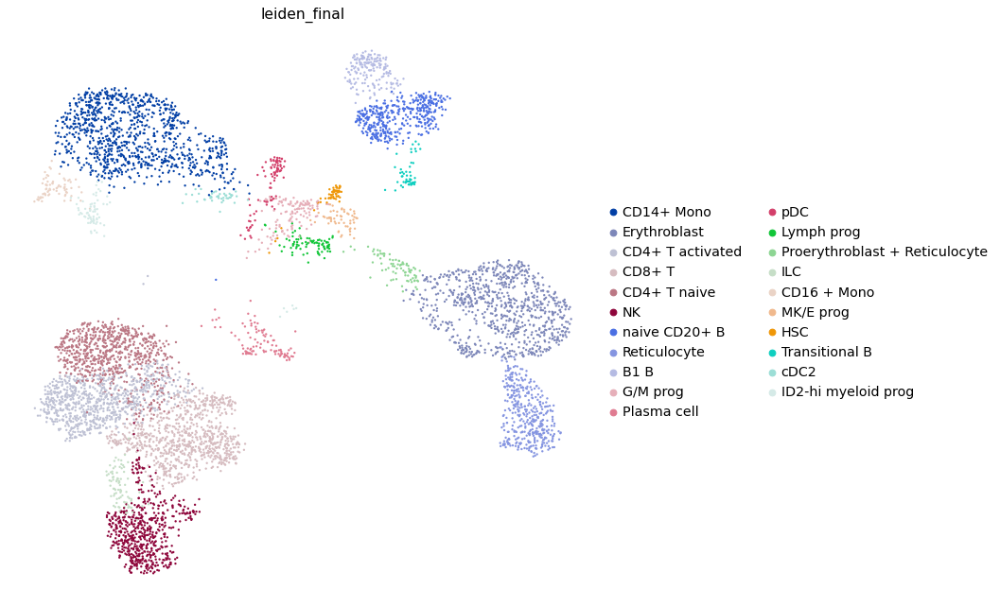

In [138]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex_filt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

# Marker overview

In [139]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

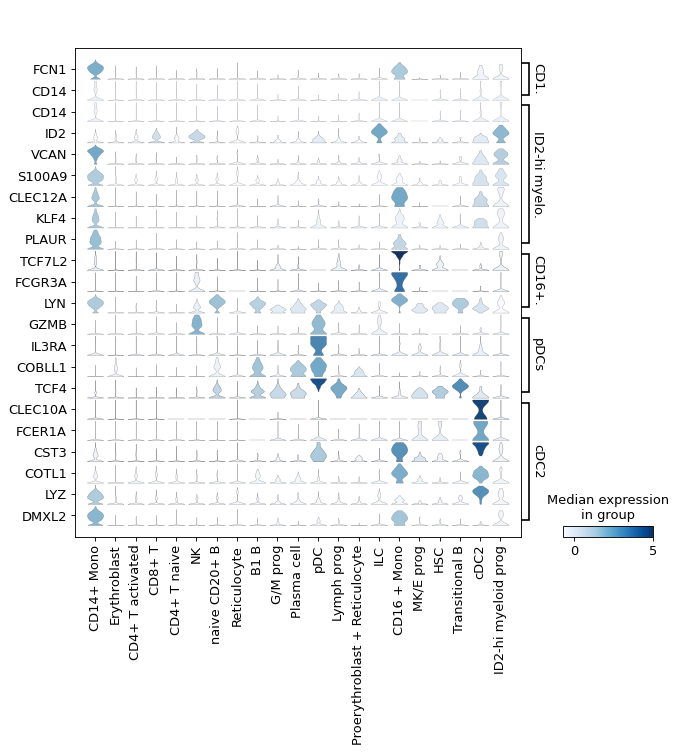

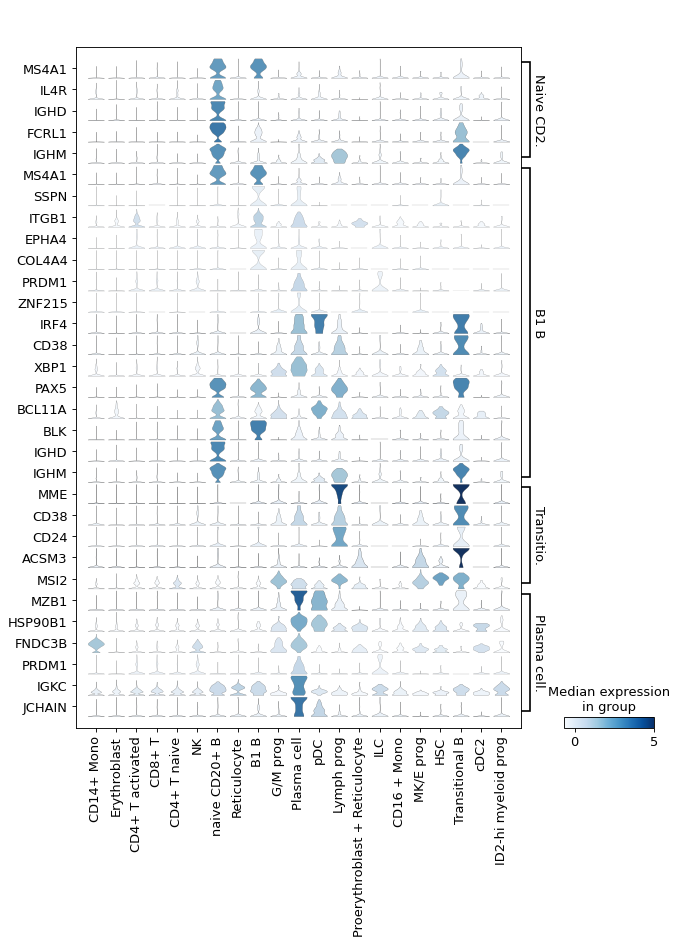

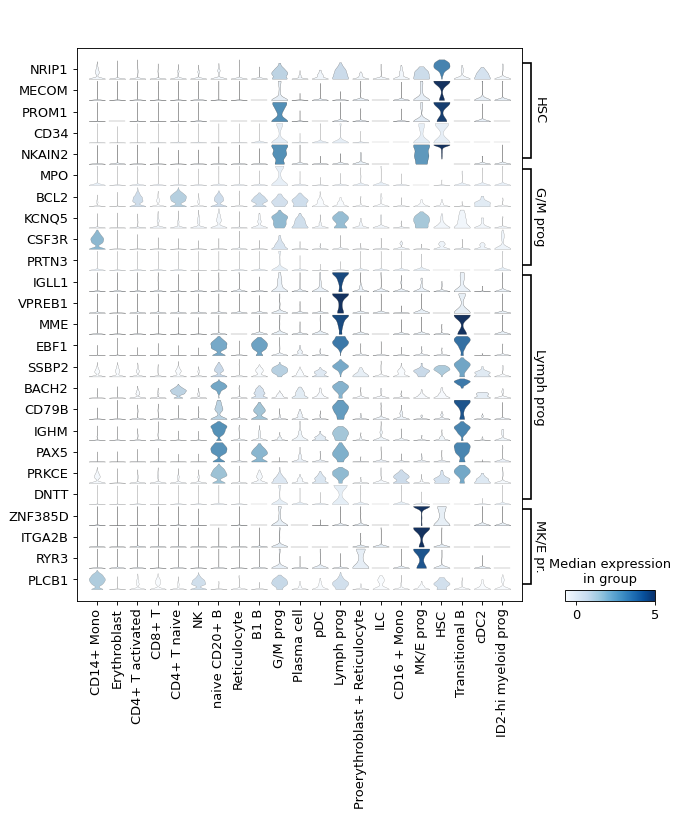

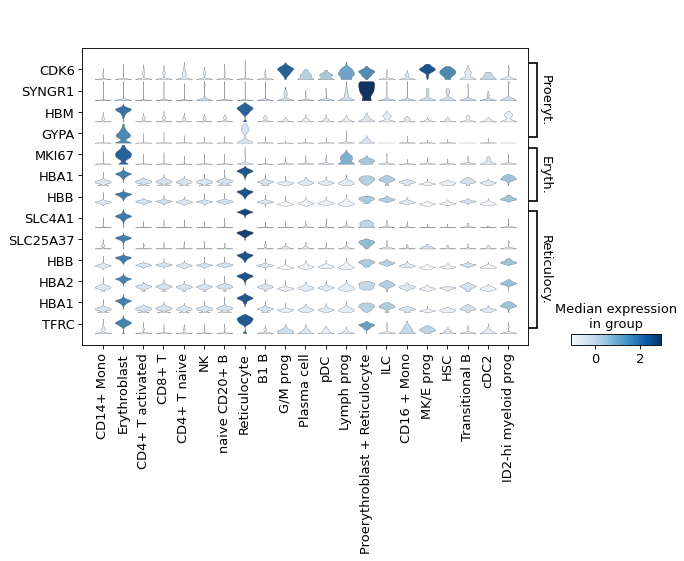

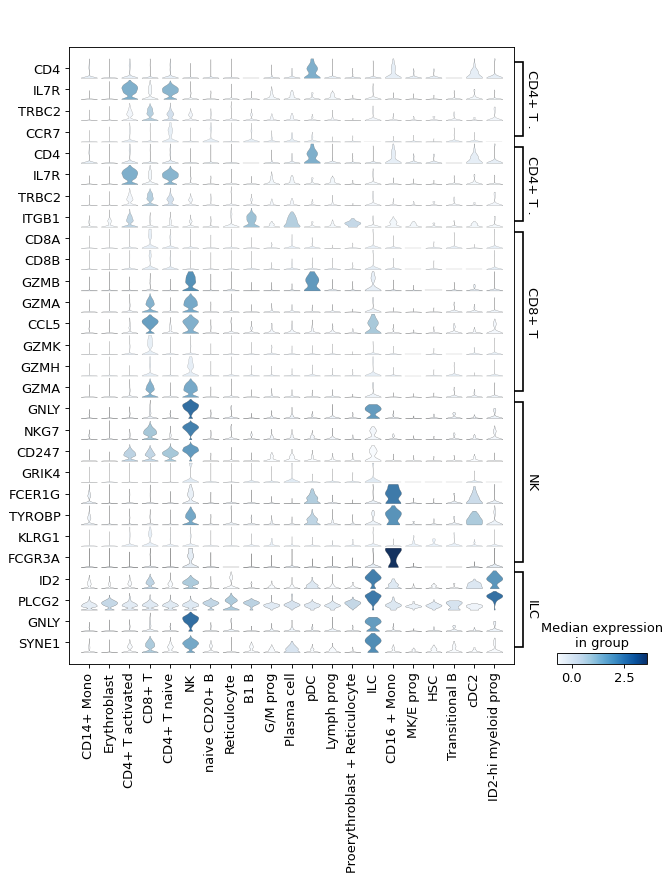

In [140]:
#Overview
adata_plot = adata_gex_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'ID2-hi myeloid prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['HSC', 'G/M prog', 'Lymph prog', 'MK/E prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})



# Write output

In [141]:
adata_gex_filt

AnnData object with n_obs × n_vars = 6746 × 17813
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_tsub', 'leiden_res0.5_msub', 'leiden_res0.5_msub2', 'leiden_res0.5_msub3', 'leiden_res0.5_bsub', 'leiden_res0.5_epsub', 'leiden_res0.5_progsub', 'leiden_res0.5_4sub', 'leiden_res0.5_6sub', 'test', 'leiden_res0.5_7sub', 'leiden_res0.5_doubsub', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means'

In [142]:
adata_gex_filt_slim = adata_gex_filt.copy()
adata_gex_filt_slim.obs = adata_gex_filt_slim.obs.drop(columns=['log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 
                                                                'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'S_score', 'G2M_score', 
                                                                'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_tsub', 'leiden_res0.5_msub',  
                                                                'leiden_res0.5_msub2', 'leiden_res0.5_bsub', 'leiden_res0.5_epsub', 'leiden_res0.5_progsub', 'leiden_res0.5_6sub', 'leiden_res0.5_7sub', 'leiden_res0.5_doubsub'])
adata_gex_filt_slim.var = adata_gex_filt_slim.var.drop(columns=['mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'means', 'dispersions', 'dispersions_norm'])

for i in ['phase_colors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_genes_res0.5', 'leiden_res0.5_tsub_colors', 'rg_res0.5_tsub', 
          'test_comp', 'rg_res0.5_msub', 'rg_res0.5_msub2', 'leiden_res0.5_bsub_colors', 'rg_res0.5_bsub', 
          'leiden_res0.5_epsub_colors', 'rg_res0.5_epsub', 'leiden_res0.5_progsub_colors', 'rg_res0.5_progsub', 'leiden_res0.5_6sub_colors', 'rg_res0.5_6sub', 'leiden_res0.5_7sub_colors', 'rg_res0.5_7sub', 'rg_res0.5_doubsub', 
           'leiden_final_colors']:
    del adata_gex_filt_slim.uns[i]
    
adata_gex_filt_slim

AnnData object with n_obs × n_vars = 6746 × 17813
    obs: 'sample', 'n_genes_by_counts', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'phase', 'leiden_res0.5_msub3', 'leiden_res0.5_4sub', 'test', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden_res0.5_msub_colors', 'leiden_res0.5_msub2_colors', 'leiden_res0.5_msub3_colors', 'rg_res0.5_msub3', 'leiden_res0.5_4sub_colors', 'rg_res0.5_4sub', 'test_colors', 'leiden_res0.5_doubsub_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [143]:
adata_gex_filt_slim.write('proc_data/S1D1_gex.h5ad')